## Preprocessing and Exploratory Data Analysis

In [3]:
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import GridSearchCV
import numpy as np

In [4]:
import seaborn as sns


In [5]:
import matplotlib.pyplot as plt

In [6]:
jan_jun_2023_df = pd.read_csv('EIA930_BALANCE_2023_Jan_Jun.csv')
jul_dec_2023_df = pd.read_csv('EIA930_BALANCE_2023_Jul_Dec.csv')
jan_jun_2024_df = pd.read_csv('EIA930_BALANCE_2024_Jan_Jun.csv')

C:\Users\dgmur\AppData\Local\Temp\ipykernel_3388\98878754.py:1: DtypeWarning: Columns (5,6,7,8,10,11,13,14,15,16,17,18,19,20,21,22,23,25,26,27,30,31,32,33,34,35,36,37,38,39,40) have mixed types. Specify dtype option on import or set low_memory=False.
  jan_jun_2023_df = pd.read_csv('EIA930_BALANCE_2023_Jan_Jun.csv')
C:\Users\dgmur\AppData\Local\Temp\ipykernel_3388\98878754.py:2: DtypeWarning: Columns (5,6,7,10,11,13,14,15,16,17,18,19,20,21,22,23,25,26,27,29,30,31,32,33,34,35,36,37,38,39,40) have mixed types. Specify dtype option on import or set low_memory=False.
  jul_dec_2023_df = pd.read_csv('EIA930_BALANCE_2023_Jul_Dec.csv')
C:\Users\dgmur\AppData\Local\Temp\ipykernel_3388\98878754.py:3: DtypeWarning: Columns (10,11,19,21,22,23,25,26,27,29,30,31,36,38,39,40) have mixed types. Specify dtype option on import or set low_memory=False.
  jan_jun_2024_df = pd.read_csv('EIA930_BALANCE_2024_Jan_Jun.csv')


In [7]:
jan_jun_2023_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 269278 entries, 0 to 269277
Data columns (total 42 columns):
 #   Column                                                             Non-Null Count   Dtype  
---  ------                                                             --------------   -----  
 0   Balancing Authority                                                269278 non-null  object 
 1   Data Date                                                          269278 non-null  object 
 2   Hour Number                                                        269278 non-null  int64  
 3   Local Time at End of Hour                                          269278 non-null  object 
 4   UTC Time at End of Hour                                            269278 non-null  object 
 5   Demand Forecast (MW)                                               229635 non-null  object 
 6   Demand (MW)                                                        229972 non-null  object 
 7   Net Generat

In [8]:
jan_jun_2023_df.isnull().sum()

Balancing Authority                                                       0
Data Date                                                                 0
Hour Number                                                               0
Local Time at End of Hour                                                 0
UTC Time at End of Hour                                                   0
Demand Forecast (MW)                                                  39643
Demand (MW)                                                           39306
Net Generation (MW)                                                     262
Total Interchange (MW)                                                  286
Sum(Valid DIBAs) (MW)                                                   357
Demand (MW) (Imputed)                                                269090
Net Generation (MW) (Imputed)                                        269112
Total Interchange (MW) (Imputed)                                     269269
Demand (MW) 

In [9]:
jul_dec_2023_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 272378 entries, 0 to 272377
Data columns (total 42 columns):
 #   Column                                                             Non-Null Count   Dtype  
---  ------                                                             --------------   -----  
 0   Balancing Authority                                                272378 non-null  object 
 1   Data Date                                                          272378 non-null  object 
 2   Hour Number                                                        272378 non-null  int64  
 3   Local Time at End of Hour                                          272378 non-null  object 
 4   UTC Time at End of Hour                                            272378 non-null  object 
 5   Demand Forecast (MW)                                               233583 non-null  object 
 6   Demand (MW)                                                        233547 non-null  object 
 7   Net Generat

In [10]:
jul_dec_2023_df.isnull().sum() + jan_jun_2023_df.isnull().sum()

Balancing Authority                                                       0
Data Date                                                                 0
Hour Number                                                               0
Local Time at End of Hour                                                 0
UTC Time at End of Hour                                                   0
Demand Forecast (MW)                                                  78438
Demand (MW)                                                           78137
Net Generation (MW)                                                     832
Total Interchange (MW)                                                 1481
Sum(Valid DIBAs) (MW)                                                  1633
Demand (MW) (Imputed)                                                541048
Net Generation (MW) (Imputed)                                        541120
Total Interchange (MW) (Imputed)                                     541636
Demand (MW) 

In [11]:
jan_jun_2024_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 130054 entries, 0 to 130053
Data columns (total 42 columns):
 #   Column                                                             Non-Null Count   Dtype  
---  ------                                                             --------------   -----  
 0   Balancing Authority                                                130054 non-null  object 
 1   Data Date                                                          130054 non-null  object 
 2   Hour Number                                                        130054 non-null  int64  
 3   Local Time at End of Hour                                          130054 non-null  object 
 4   UTC Time at End of Hour                                            130054 non-null  object 
 5   Demand Forecast (MW)                                               112757 non-null  object 
 6   Demand (MW)                                                        111580 non-null  object 
 7   Net Generat

In [12]:
jul_dec_2023_df.isnull().sum() + jan_jun_2023_df.isnull().sum() + jan_jun_2024_df.isnull().sum()

Balancing Authority                                                       0
Data Date                                                                 0
Hour Number                                                               0
Local Time at End of Hour                                                 0
UTC Time at End of Hour                                                   0
Demand Forecast (MW)                                                  95735
Demand (MW)                                                           96611
Net Generation (MW)                                                    2513
Total Interchange (MW)                                                 3519
Sum(Valid DIBAs) (MW)                                                  5181
Demand (MW) (Imputed)                                                670803
Net Generation (MW) (Imputed)                                        670798
Total Interchange (MW) (Imputed)                                     671686
Demand (MW) 

In [13]:
df = pd.concat([jan_jun_2023_df, jul_dec_2023_df, jan_jun_2024_df], axis = 0).reset_index()

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 671710 entries, 0 to 671709
Data columns (total 43 columns):
 #   Column                                                             Non-Null Count   Dtype  
---  ------                                                             --------------   -----  
 0   index                                                              671710 non-null  int64  
 1   Balancing Authority                                                671710 non-null  object 
 2   Data Date                                                          671710 non-null  object 
 3   Hour Number                                                        671710 non-null  int64  
 4   Local Time at End of Hour                                          671710 non-null  object 
 5   UTC Time at End of Hour                                            671710 non-null  object 
 6   Demand Forecast (MW)                                               575975 non-null  object 
 7   Demand (MW)

In [15]:
df.isnull().sum()

index                                                                     0
Balancing Authority                                                       0
Data Date                                                                 0
Hour Number                                                               0
Local Time at End of Hour                                                 0
UTC Time at End of Hour                                                   0
Demand Forecast (MW)                                                  95735
Demand (MW)                                                           96611
Net Generation (MW)                                                    2513
Total Interchange (MW)                                                 3519
Sum(Valid DIBAs) (MW)                                                  5181
Demand (MW) (Imputed)                                                670803
Net Generation (MW) (Imputed)                                        670798
Total Interc

In [16]:
exclude_authority = ['YAD', 'SEPA', 'GLHB', 'DEAA', 'HGMA', 'GRID', 'AVRN', 'GWA', 'WWA', 'GRIF', 'WAUW']
df = df[~df['Balancing Authority'].isin(exclude_authority)]

In [17]:
df.isnull().sum()

index                                                                     0
Balancing Authority                                                       0
Data Date                                                                 0
Hour Number                                                               0
Local Time at End of Hour                                                 0
UTC Time at End of Hour                                                   0
Demand Forecast (MW)                                                   1469
Demand (MW)                                                            2321
Net Generation (MW)                                                    2325
Total Interchange (MW)                                                 3331
Sum(Valid DIBAs) (MW)                                                  4729
Demand (MW) (Imputed)                                                565642
Net Generation (MW) (Imputed)                                        565777
Total Interc

In [18]:
df.isnull().sum()/len(df)

index                                                                0.000000
Balancing Authority                                                  0.000000
Data Date                                                            0.000000
Hour Number                                                          0.000000
Local Time at End of Hour                                            0.000000
UTC Time at End of Hour                                              0.000000
Demand Forecast (MW)                                                 0.002593
Demand (MW)                                                          0.004097
Net Generation (MW)                                                  0.004104
Total Interchange (MW)                                               0.005879
Sum(Valid DIBAs) (MW)                                                0.008347
Demand (MW) (Imputed)                                                0.998399
Net Generation (MW) (Imputed)                                   

In [19]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 566549 entries, 0 to 665352
Data columns (total 43 columns):
 #   Column                                                             Non-Null Count   Dtype  
---  ------                                                             --------------   -----  
 0   index                                                              566549 non-null  int64  
 1   Balancing Authority                                                566549 non-null  object 
 2   Data Date                                                          566549 non-null  object 
 3   Hour Number                                                        566549 non-null  int64  
 4   Local Time at End of Hour                                          566549 non-null  object 
 5   UTC Time at End of Hour                                            566549 non-null  object 
 6   Demand Forecast (MW)                                               565080 non-null  object 
 7   Demand (MW)

In [20]:
columns_over_30_percent_missing = [column for column in df.columns if df[column].isnull().sum()/len(df) > .30]
print(columns_over_30_percent_missing)
df.drop(columns_over_30_percent_missing, axis = 1, inplace=True)

['Demand (MW) (Imputed)', 'Net Generation (MW) (Imputed)', 'Total Interchange (MW) (Imputed)', 'Net Generation (MW) from Coal', 'Net Generation (MW) from Nuclear', 'Net Generation (MW) from All Petroleum Products', 'Net Generation (MW) from Wind', 'Net Generation (MW) from Other Fuel Sources', 'Net Generation (MW) from Unknown Fuel Sources', 'Net Generation (MW) from Coal (Imputed)', 'Net Generation (MW) from Natural Gas (Imputed)', 'Net Generation (MW) from Nuclear (Imputed)', 'Net Generation (MW) from All Petroleum Products (Imputed)', 'Net Generation (MW) from Hydropower and Pumped Storage (Imputed)', 'Net Generation (MW) from Solar (Imputed)', 'Net Generation (MW) from Wind (Imputed)', 'Net Generation (MW) from Other Fuel Sources (Imputed)', 'Net Generation (MW) from Coal (Adjusted)', 'Net Generation (MW) from Nuclear (Adjusted)', 'Net Generation (MW) from All Petroleum Products (Adjusted)', 'Net Generation (MW) from Wind (Adjusted)', 'Net Generation (MW) from Other Fuel Sources (A

In [21]:
print(df.shape)
print(df.info())

(566549, 21)
<class 'pandas.core.frame.DataFrame'>
Int64Index: 566549 entries, 0 to 665352
Data columns (total 21 columns):
 #   Column                                                             Non-Null Count   Dtype 
---  ------                                                             --------------   ----- 
 0   index                                                              566549 non-null  int64 
 1   Balancing Authority                                                566549 non-null  object
 2   Data Date                                                          566549 non-null  object
 3   Hour Number                                                        566549 non-null  int64 
 4   Local Time at End of Hour                                          566549 non-null  object
 5   UTC Time at End of Hour                                            566549 non-null  object
 6   Demand Forecast (MW)                                               565080 non-null  object
 7   Demand 

In [22]:
df.head()

,index,Balancing Authority,Data Date,Hour Number,Local Time at End of Hour,UTC Time at End of Hour,Demand Forecast (MW),Demand (MW),Net Generation (MW),Total Interchange (MW),...,Demand (MW) (Adjusted),Net Generation (MW) (Adjusted),Total Interchange (MW) (Adjusted),Net Generation (MW) from Natural Gas,Net Generation (MW) from Hydropower and Pumped Storage,Net Generation (MW) from Solar,Net Generation (MW) from Natural Gas (Adjusted),Net Generation (MW) from Hydropower and Pumped Storage (Adjusted),Net Generation (MW) from Solar (Adjusted),Region
0,0,AECI,01/01/2023,1,01/01/2023 1:00:00 AM,01/01/2023 7:00:00 AM,"2,467","2,495","2,698",203,...,"2,495","2,698",203,969,NaN,NaN,969,NaN,NaN,MIDW
1,1,AECI,01/01/2023,2,01/01/2023 2:00:00 AM,01/01/2023 8:00:00 AM,"2,430","2,468","2,649",181,...,"2,468","2,649",181,956,NaN,NaN,956,NaN,NaN,MIDW
2,2,AECI,01/01/2023,3,01/01/2023 3:00:00 AM,01/01/2023 9:00:00 AM,"2,432","2,436","2,604",168,...,"2,436","2,604",168,944,NaN,NaN,944,NaN,NaN,MIDW
3,3,AECI,01/01/2023,4,01/01/2023 4:00:00 AM,01/01/2023 10:00:00 AM,"2,443","2,444","2,624",180,...,"2,444","2,624",180,935,NaN,NaN,935,NaN,NaN,MIDW
4,4,AECI,01/01/2023,5,01/01/2023 5:00:00 AM,01/01/2023 11:00:00 AM,"2,480","2,473","2,667",194,...,"2,473","2,667",194,924,NaN,NaN,924,NaN,NaN,MIDW


In [23]:
df.isnull().sum()

index                                                                     0
Balancing Authority                                                       0
Data Date                                                                 0
Hour Number                                                               0
Local Time at End of Hour                                                 0
UTC Time at End of Hour                                                   0
Demand Forecast (MW)                                                   1469
Demand (MW)                                                            2321
Net Generation (MW)                                                    2325
Total Interchange (MW)                                                 3331
Sum(Valid DIBAs) (MW)                                                  4729
Demand (MW) (Adjusted)                                                 1636
Net Generation (MW) (Adjusted)                                         1636
Total Interc

In [24]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 566549 entries, 0 to 665352
Data columns (total 21 columns):
 #   Column                                                             Non-Null Count   Dtype 
---  ------                                                             --------------   ----- 
 0   index                                                              566549 non-null  int64 
 1   Balancing Authority                                                566549 non-null  object
 2   Data Date                                                          566549 non-null  object
 3   Hour Number                                                        566549 non-null  int64 
 4   Local Time at End of Hour                                          566549 non-null  object
 5   UTC Time at End of Hour                                            566549 non-null  object
 6   Demand Forecast (MW)                                               565080 non-null  object
 7   Demand (MW)         

In [25]:
for i in df.iloc[:,6:20].columns:
    if df[i].str.contains(',').any():
        df[i] = df[i].str.replace(',', '')
        df[i] = df[i].astype('float64')
    else:
        df[i] = df[i].astype('float64')    

In [26]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 566549 entries, 0 to 665352
Data columns (total 21 columns):
 #   Column                                                             Non-Null Count   Dtype  
---  ------                                                             --------------   -----  
 0   index                                                              566549 non-null  int64  
 1   Balancing Authority                                                566549 non-null  object 
 2   Data Date                                                          566549 non-null  object 
 3   Hour Number                                                        566549 non-null  int64  
 4   Local Time at End of Hour                                          566549 non-null  object 
 5   UTC Time at End of Hour                                            566549 non-null  object 
 6   Demand Forecast (MW)                                               553720 non-null  float64
 7   Demand (MW)

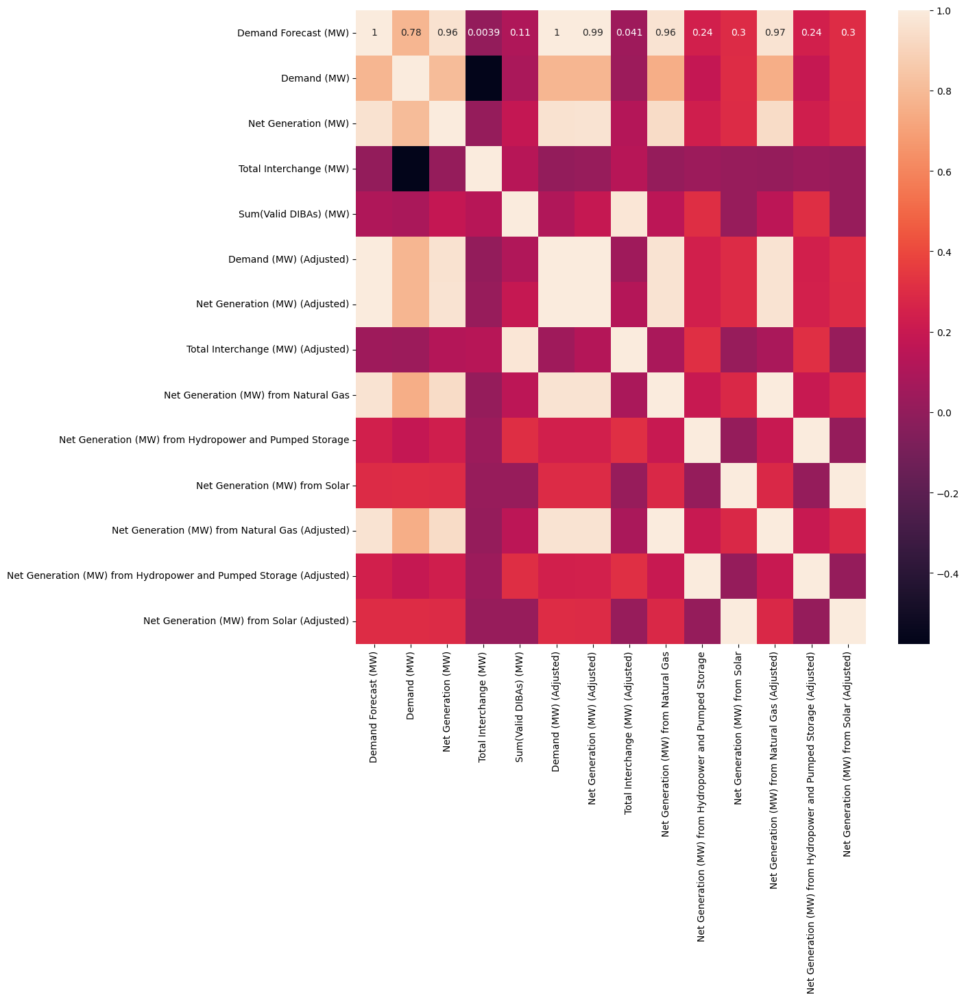

In [27]:
plt.figure(figsize=(12,12))
sns.heatmap(df.select_dtypes(include= 'float64').corr(), annot=True)
plt.show()

In [28]:
def correlation(dataset, threshold):
    col_corr = set() # Set of all the names of deleted columns
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if (corr_matrix.iloc[i, j] >= threshold) and (corr_matrix.columns[j] not in col_corr):
                colname = corr_matrix.columns[i] # getting the name of column
                col_corr.add(colname)
                if colname in dataset.columns:
                    del dataset[colname] # deleting the column from the dataset

    return dataset

In [29]:
corr_removed_df = correlation(df.select_dtypes(include='float64'), .90)

In [30]:
corr_removed_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 566549 entries, 0 to 665352
Data columns (total 6 columns):
 #   Column                                                  Non-Null Count   Dtype  
---  ------                                                  --------------   -----  
 0   Demand Forecast (MW)                                    553720 non-null  float64
 1   Demand (MW)                                             552868 non-null  float64
 2   Total Interchange (MW)                                  563218 non-null  float64
 3   Sum(Valid DIBAs) (MW)                                   561820 non-null  float64
 4   Net Generation (MW) from Hydropower and Pumped Storage  419858 non-null  float64
 5   Net Generation (MW) from Solar                          316962 non-null  float64
dtypes: float64(6)
memory usage: 30.3 MB


<Axes: >

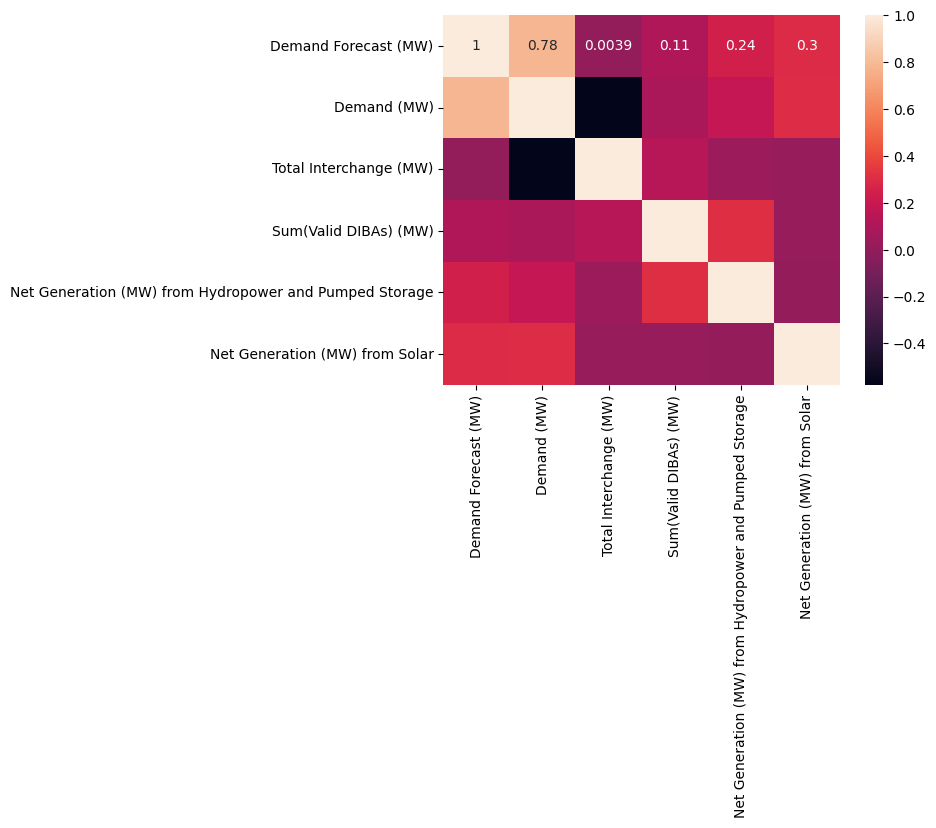

In [31]:
uncorrelated_features = corr_removed_df.columns.to_list()
non_float_features = df.select_dtypes(exclude='float').columns.to_list()
sns.heatmap(df[uncorrelated_features].corr(), annot = True)


In [32]:

df = pd.concat([df[non_float_features],df[uncorrelated_features]], axis = 1)

df.head()

,index,Balancing Authority,Data Date,Hour Number,Local Time at End of Hour,UTC Time at End of Hour,Region,Demand Forecast (MW),Demand (MW),Total Interchange (MW),Sum(Valid DIBAs) (MW),Net Generation (MW) from Hydropower and Pumped Storage,Net Generation (MW) from Solar
0,0,AECI,01/01/2023,1,01/01/2023 1:00:00 AM,01/01/2023 7:00:00 AM,MIDW,2467.0,2495.0,203.0,203.0,NaN,NaN
1,1,AECI,01/01/2023,2,01/01/2023 2:00:00 AM,01/01/2023 8:00:00 AM,MIDW,2430.0,2468.0,181.0,181.0,NaN,NaN
2,2,AECI,01/01/2023,3,01/01/2023 3:00:00 AM,01/01/2023 9:00:00 AM,MIDW,2432.0,2436.0,168.0,168.0,NaN,NaN
3,3,AECI,01/01/2023,4,01/01/2023 4:00:00 AM,01/01/2023 10:00:00 AM,MIDW,2443.0,2444.0,180.0,180.0,NaN,NaN
4,4,AECI,01/01/2023,5,01/01/2023 5:00:00 AM,01/01/2023 11:00:00 AM,MIDW,2480.0,2473.0,194.0,194.0,NaN,NaN


In [33]:
df.shape

(566549, 13)

In [34]:
df = df.sort_values(by = 'UTC Time at End of Hour')

In [35]:
df.head(50)

,index,Balancing Authority,Data Date,Hour Number,Local Time at End of Hour,UTC Time at End of Hour,Region,Demand Forecast (MW),Demand (MW),Total Interchange (MW),Sum(Valid DIBAs) (MW),Net Generation (MW) from Hydropower and Pumped Storage,Net Generation (MW) from Solar
165045,165045,PJM,01/01/2023,5,01/01/2023 5:00:00 AM,01/01/2023 10:00:00 AM,MIDA,72696.0,72438.0,3378.0,5985.0,941.0,8.0
191101,191101,SCL,01/01/2023,2,01/01/2023 2:00:00 AM,01/01/2023 10:00:00 AM,NW,966.0,1028.0,-778.0,-778.0,250.0,NaN
60808,60808,ERCO,01/01/2023,4,01/01/2023 4:00:00 AM,01/01/2023 10:00:00 AM,TEX,35373.0,34227.0,678.0,678.0,5.0,0.0
112924,112924,IPCO,01/01/2023,2,01/01/2023 2:00:00 AM,01/01/2023 10:00:00 AM,NW,1858.0,1802.0,-844.0,-844.0,523.0,NaN
125953,125953,LDWP,01/01/2023,2,01/01/2023 2:00:00 AM,01/01/2023 10:00:00 AM,CAL,2262.0,2353.0,-823.0,-823.0,3.0,0.0
78178,78178,GCPD,01/01/2023,2,01/01/2023 2:00:00 AM,01/01/2023 10:00:00 AM,NW,649.0,675.0,40.0,40.0,712.0,NaN
221506,221506,TAL,01/01/2023,5,01/01/2023 5:00:00 AM,01/01/2023 10:00:00 AM,FLA,184.0,186.0,76.0,76.0,NaN,NaN
121613,121613,JEA,01/01/2023,5,01/01/2023 5:00:00 AM,01/01/2023 10:00:00 AM,FLA,962.0,915.0,-42.0,-42.0,NaN,0.0
108581,108581,IID,01/01/2023,2,01/01/2023 2:00:00 AM,01/01/2023 10:00:00 AM,CAL,249.0,252.0,270.0,270.0,0.0,NaN
234533,234533,TIDC,01/01/2023,2,01/01/2023 2:00:00 AM,01/01/2023 10:00:00 AM,CAL,239.0,234.0,-31.0,-31.0,1.0,NaN


In [36]:
df[df['Net Generation (MW) from Hydropower and Pumped Storage'].isnull()].index.to_list()

[221506,
 121613,
 65152,
 73838,
 195447,
 104241,
 230190,
 3,
 56463,
 91211,
 225849,
 91223,
 65164,
 56475,
 230202,
 225861,
 104253,
 73850,
 15,
 121625,
 195459,
 221518,
 91212,
 73839,
 56464,
 121614,
 221507,
 195448,
 4,
 65153,
 104242,
 225850,
 230191,
 121626,
 104254,
 91224,
 16,
 225862,
 65165,
 195460,
 56476,
 221519,
 73851,
 230203,
 91213,
 121615,
 73840,
 225851,
 195449,
 56465,
 65154,
 230192,
 5,
 104243,
 221508,
 104244,
 73841,
 195450,
 56466,
 230193,
 221509,
 91214,
 225852,
 121616,
 6,
 65155,
 73842,
 91215,
 65156,
 225853,
 56467,
 221510,
 195451,
 121617,
 230194,
 7,
 104245,
 225854,
 195452,
 56468,
 104246,
 65157,
 230195,
 73843,
 121618,
 221511,
 8,
 91216,
 225855,
 121619,
 65158,
 9,
 73844,
 91217,
 56469,
 230196,
 195453,
 221512,
 104247,
 121620,
 10,
 221513,
 104248,
 195454,
 73845,
 56470,
 91218,
 230197,
 225856,
 65159,
 221502,
 65148,
 121609,
 195443,
 104237,
 225845,
 73834,
 91207,
 11,
 195455,
 56471,
 10424

In [37]:
null_counts = df[df['Net Generation (MW) from Hydropower and Pumped Storage'].isnull()].groupby('Balancing Authority').size().reset_index(name='Number of nulls').sort_values(by = 'Number of nulls', ascending=False)
null_counts.head(50)


,Balancing Authority,Number of nulls
46,TEPC,10896
11,EPE,10896
0,AECI,10895
39,SEC,10895
17,GVL,10895
15,FPL,10895
13,FMPP,10895
22,JEA,10895
18,HST,10895
44,TAL,10895


In [38]:
df.isnull().sum()

index                                                          0
Balancing Authority                                            0
Data Date                                                      0
Hour Number                                                    0
Local Time at End of Hour                                      0
UTC Time at End of Hour                                        0
Region                                                         0
Demand Forecast (MW)                                       12829
Demand (MW)                                                13681
Total Interchange (MW)                                      3331
Sum(Valid DIBAs) (MW)                                       4729
Net Generation (MW) from Hydropower and Pumped Storage    146691
Net Generation (MW) from Solar                            249587
dtype: int64

In [39]:
df.describe()

,index,Hour Number,Demand Forecast (MW),Demand (MW),Total Interchange (MW),Sum(Valid DIBAs) (MW),Net Generation (MW) from Hydropower and Pumped Storage,Net Generation (MW) from Solar
count,566549.000000,566549.000000,553720.000000,5.528680e+05,5.632180e+05,561820.000000,419858.000000,316962.000000
mean,120161.507575,12.499203,9056.596679,9.124968e+03,-1.146544e+02,-70.089977,732.480231,530.841593
std,74532.705269,6.921862,17905.123131,2.277647e+04,1.331429e+04,1915.553279,1331.039853,1705.060738
min,0.000000,1.000000,-50457.000000,-5.828600e+04,-9.903097e+06,-57280.000000,-51349.000000,-332.000000
25%,56571.000000,6.000000,1010.000000,1.011000e+03,-6.720000e+02,-676.000000,33.000000,0.000000
50%,115679.000000,12.000000,2517.000000,2.587000e+03,-6.600000e+01,-67.000000,272.000000,2.000000
75%,182489.000000,18.000000,6394.000000,6.496000e+03,3.290000e+02,327.000000,834.000000,204.000000
max,259126.000000,25.000000,381892.000000,9.931754e+06,6.550500e+04,24000.000000,14182.000000,41198.000000


In [40]:
df = df.sort_values(by=['Balancing Authority', 'UTC Time at End of Hour'])

In [41]:
for columns in df.columns: 
    df[columns] = df[columns].interpolate(method = 'linear')

In [42]:
df.isnull().sum()

index                                                         0
Balancing Authority                                           0
Data Date                                                     0
Hour Number                                                   0
Local Time at End of Hour                                     0
UTC Time at End of Hour                                       0
Region                                                        0
Demand Forecast (MW)                                          0
Demand (MW)                                                   0
Total Interchange (MW)                                        0
Sum(Valid DIBAs) (MW)                                         0
Net Generation (MW) from Hydropower and Pumped Storage    10895
Net Generation (MW) from Solar                            10910
dtype: int64

In [43]:
df['Net Generation (MW) from Hydropower and Pumped Storage'] = df['Net Generation (MW) from Hydropower and Pumped Storage'].bfill()


In [44]:
df['Net Generation (MW) from Solar'] = df['Net Generation (MW) from Solar'].bfill()


In [45]:
print(df.isnull().sum())

index                                                     0
Balancing Authority                                       0
Data Date                                                 0
Hour Number                                               0
Local Time at End of Hour                                 0
UTC Time at End of Hour                                   0
Region                                                    0
Demand Forecast (MW)                                      0
Demand (MW)                                               0
Total Interchange (MW)                                    0
Sum(Valid DIBAs) (MW)                                     0
Net Generation (MW) from Hydropower and Pumped Storage    0
Net Generation (MW) from Solar                            0
dtype: int64


In [46]:
df.describe()

,index,Hour Number,Demand Forecast (MW),Demand (MW),Total Interchange (MW),Sum(Valid DIBAs) (MW),Net Generation (MW) from Hydropower and Pumped Storage,Net Generation (MW) from Solar
count,566549.000000,566549.000000,566549.000000,5.665490e+05,5.665490e+05,566549.000000,566549.000000,566549.000000
mean,120161.507575,12.499203,8871.487475,8.941738e+03,-1.140144e+02,-67.471326,608.230706,423.172719
std,74532.705269,6.921862,17760.801225,2.255912e+04,1.327577e+04,1913.389168,1179.697268,1357.955929
min,0.000000,1.000000,-50457.000000,-5.828600e+04,-9.903097e+06,-57280.000000,-51349.000000,-332.000000
25%,56571.000000,6.000000,864.000000,8.690000e+02,-6.710000e+02,-672.000000,38.000000,0.000000
50%,115679.000000,12.000000,2454.000000,2.516000e+03,-6.600000e+01,-66.000000,251.000000,0.000000
75%,182489.000000,18.000000,6201.000000,6.314000e+03,3.310000e+02,328.000000,651.000000,144.960000
max,259126.000000,25.000000,381892.000000,9.931754e+06,6.550500e+04,24000.000000,14182.000000,41198.000000


In [47]:
demand_missing_df = df[df['Net Generation (MW) from Hydropower and Pumped Storage'].isnull()]

In [48]:
demand_missing_df

,index,Balancing Authority,Data Date,Hour Number,Local Time at End of Hour,UTC Time at End of Hour,Region,Demand Forecast (MW),Demand (MW),Total Interchange (MW),Sum(Valid DIBAs) (MW),Net Generation (MW) from Hydropower and Pumped Storage,Net Generation (MW) from Solar


In [49]:
#df['Net Generation (MW) from Hydropower and Pumped Storage'] = df['Net Generation (MW) from Hydropower and Pumped Storage'].fillna(df['Net Generation (MW) from Hydropower and Pumped Storage (Adjusted)'].combine_first(df['Net Generation (MW) from Hydropower and Pumped Storage (Adjusted)']))

In [50]:
#df['Net Generation (MW) from Solar'] = df['Net Generation (MW) from Solar'].fillna(df['Net Generation (MW) from Solar (Adjusted)'].combine_first(df['Net Generation (MW) from Solar']))

In [51]:
df.isnull().sum()

index                                                     0
Balancing Authority                                       0
Data Date                                                 0
Hour Number                                               0
Local Time at End of Hour                                 0
UTC Time at End of Hour                                   0
Region                                                    0
Demand Forecast (MW)                                      0
Demand (MW)                                               0
Total Interchange (MW)                                    0
Sum(Valid DIBAs) (MW)                                     0
Net Generation (MW) from Hydropower and Pumped Storage    0
Net Generation (MW) from Solar                            0
dtype: int64

In [52]:
df.shape

(566549, 13)

In [53]:
df['Region'].value_counts()

NW      174321
FLA      98055
SW       65376
CAL      54475
CAR      54475
MIDW     32687
CENT     21790
TEX      10895
NE       10895
NY       10895
MIDA     10895
SE       10895
TEN      10895
Name: Region, dtype: int64

In [54]:
df['Balancing Authority'].nunique()

52

In [55]:
reigon_mapping = {'NW': 'Idaho', 'FLA': 'Florida', 'SW': 'Arizona', 'CAL': 'California', 'MIDW': 'Ohio', 'CENT': 'Kansas', 'TEX': 'Texas', 'NE':'Connecticut', 'NY': 'New York', 'MIDA': 'Pennsylvania', 'SE': 'Georgia', 'TEN': 'Tennessee', 'CAR': 'North Carolina'}
df['State_Rep_Region'] = df['Region'].map(reigon_mapping)

In [56]:
df['State_Rep_Region'].isnull().sum()

0

In [57]:
# importing geopy library
from geopy.geocoders import Nominatim

# calling the Nominatim tool
loc = Nominatim(user_agent="GetLoc")

# entering the location name

In [58]:
longitude_mapping = {'Idaho': loc.geocode('Idaho').longitude, 'Florida': loc.geocode('Florida').longitude, 'Arizona': loc.geocode('Arizona').longitude, 'California': loc.geocode('California').longitude, 'Ohio':loc.geocode('Ohio').longitude,
  'Kansas': loc.geocode('Kansas').longitude, 'Texas': loc.geocode('Texas').longitude, 'Connecticut': loc.geocode('Connecticut').longitude, 'New York': loc.geocode('New York').longitude, 'Pennsylvania': loc.geocode('Pennsylvania').longitude, 
  'Georgia': loc.geocode('Atlanta').longitude, 'Tennessee': loc.geocode('Tennessee').longitude, 'North Carolina': loc.geocode('North Carolina').longitude}

In [59]:
latitude_mapping = {'Idaho': loc.geocode('Idaho').latitude, 'Florida': loc.geocode('Florida').latitude, 'Arizona': loc.geocode('Arizona').latitude, 'California': loc.geocode('California').latitude, 'Ohio':loc.geocode('Ohio').latitude,
  'Kansas': loc.geocode('Kansas').latitude, 'Texas': loc.geocode('Texas').latitude, 'Connecticut': loc.geocode('Connecticut').latitude, 'New York': loc.geocode('New York').latitude, 'Pennsylvania': loc.geocode('Pennsylvania').latitude, 
  'Georgia': loc.geocode('Atlanta').latitude, 'Tennessee': loc.geocode('Tennessee').latitude, 'North Carolina': loc.geocode('North Carolina').latitude}

In [60]:
df['Longitude'] = df['State_Rep_Region'].map(longitude_mapping)
df['Latitude'] = df['State_Rep_Region'].map(latitude_mapping)

In [61]:
df.isnull().sum()

index                                                     0
Balancing Authority                                       0
Data Date                                                 0
Hour Number                                               0
Local Time at End of Hour                                 0
UTC Time at End of Hour                                   0
Region                                                    0
Demand Forecast (MW)                                      0
Demand (MW)                                               0
Total Interchange (MW)                                    0
Sum(Valid DIBAs) (MW)                                     0
Net Generation (MW) from Hydropower and Pumped Storage    0
Net Generation (MW) from Solar                            0
State_Rep_Region                                          0
Longitude                                                 0
Latitude                                                  0
dtype: int64

In [62]:
df

,index,Balancing Authority,Data Date,Hour Number,Local Time at End of Hour,UTC Time at End of Hour,Region,Demand Forecast (MW),Demand (MW),Total Interchange (MW),Sum(Valid DIBAs) (MW),Net Generation (MW) from Hydropower and Pumped Storage,Net Generation (MW) from Solar,State_Rep_Region,Longitude,Latitude
3,3,AECI,01/01/2023,4,01/01/2023 4:00:00 AM,01/01/2023 10:00:00 AM,MIDW,2443.0,2444.0,180.0,180.0,230.0,0.0,Ohio,-82.688140,40.225357
15,15,AECI,01/01/2023,16,01/01/2023 4:00:00 PM,01/01/2023 10:00:00 PM,MIDW,2450.0,2279.0,293.0,293.0,230.0,0.0,Ohio,-82.688140,40.225357
4,4,AECI,01/01/2023,5,01/01/2023 5:00:00 AM,01/01/2023 11:00:00 AM,MIDW,2480.0,2473.0,194.0,194.0,230.0,0.0,Ohio,-82.688140,40.225357
16,16,AECI,01/01/2023,17,01/01/2023 5:00:00 PM,01/01/2023 11:00:00 PM,MIDW,2527.0,2298.0,521.0,521.0,230.0,0.0,Ohio,-82.688140,40.225357
5,5,AECI,01/01/2023,6,01/01/2023 6:00:00 AM,01/01/2023 12:00:00 PM,MIDW,2549.0,2524.0,58.0,58.0,230.0,0.0,Ohio,-82.688140,40.225357
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
528392,259114,WALC,12/31/2023,12,12/31/2023 12:00:00 PM,12/31/2023 7:00:00 PM,SW,546.0,497.0,273.0,273.0,141.0,0.0,Arizona,-111.763275,34.395342
528381,259103,WALC,12/31/2023,1,12/31/2023 1:00:00 AM,12/31/2023 8:00:00 AM,SW,541.0,589.0,326.0,326.0,298.0,0.0,Arizona,-111.763275,34.395342
528393,259115,WALC,12/31/2023,13,12/31/2023 1:00:00 PM,12/31/2023 8:00:00 PM,SW,527.0,471.0,295.0,295.0,90.0,0.0,Arizona,-111.763275,34.395342
528382,259104,WALC,12/31/2023,2,12/31/2023 2:00:00 AM,12/31/2023 9:00:00 AM,SW,543.0,576.0,256.0,256.0,154.0,0.0,Arizona,-111.763275,34.395342


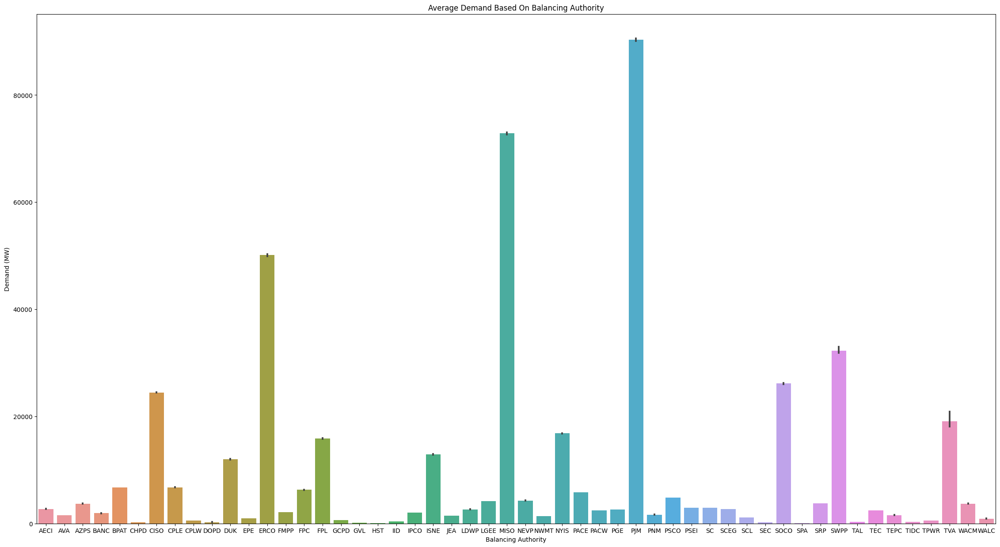

In [63]:
import seaborn as sns 
import matplotlib.pyplot as plt

plt.figure(figsize=(28,15))
sns.barplot(data = df, x = 'Balancing Authority', y = 'Demand (MW)')
plt.title('Average Demand Based On Balancing Authority')
plt.show()

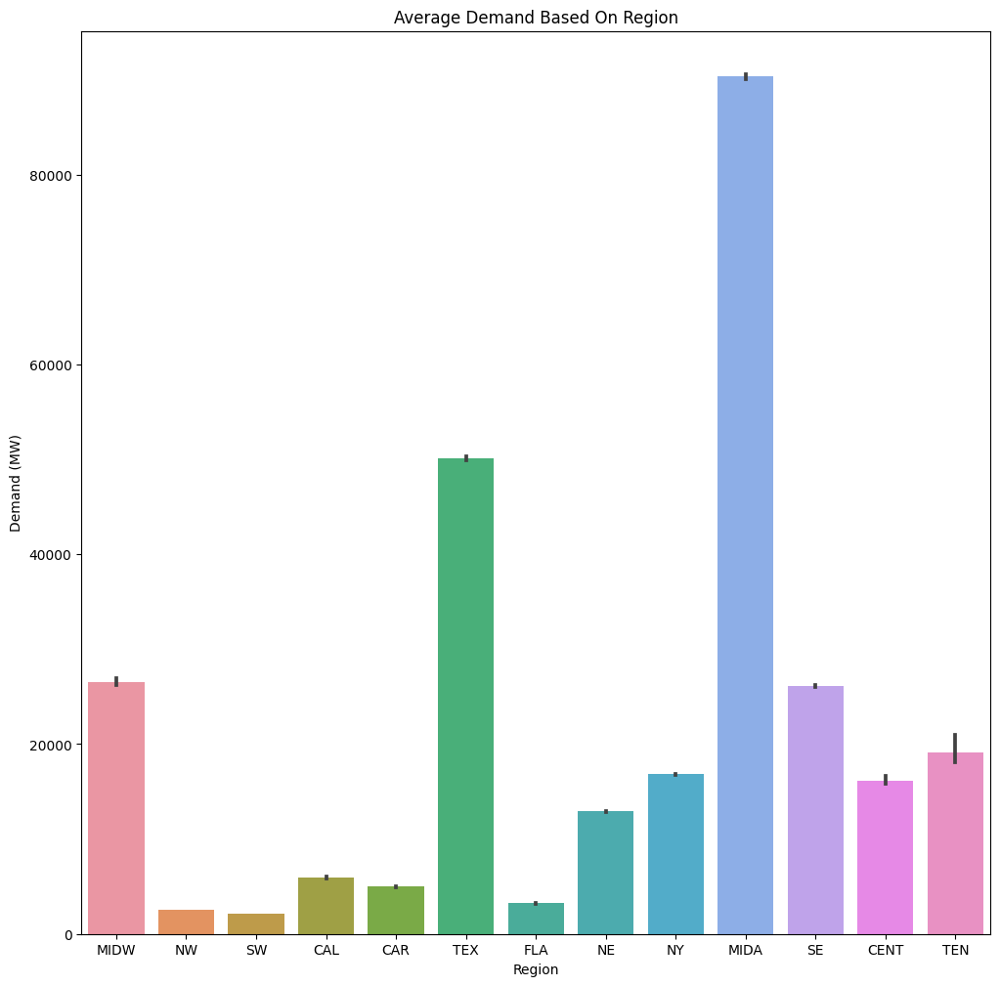

In [64]:
plt.figure(figsize = (12,12))
sns.barplot(data = df, x = 'Region', y = 'Demand (MW)')
plt.title('Average Demand Based On Region')
plt.show()

In [65]:
df.columns.to_list()

['index',
 'Balancing Authority',
 'Data Date',
 'Hour Number',
 'Local Time at End of Hour',
 'UTC Time at End of Hour',
 'Region',
 'Demand Forecast (MW)',
 'Demand (MW)',
 'Total Interchange (MW)',
 'Sum(Valid DIBAs) (MW)',
 'Net Generation (MW) from Hydropower and Pumped Storage',
 'Net Generation (MW) from Solar',
 'State_Rep_Region',
 'Longitude',
 'Latitude']

In [66]:
numerical_columns = [
 'Demand (MW)',
 'Total Interchange (MW)',
 'Sum(Valid DIBAs) (MW)',
 'Net Generation (MW) from Hydropower and Pumped Storage',
 'Net Generation (MW) from Solar']

In [67]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 566549 entries, 3 to 528394
Data columns (total 16 columns):
 #   Column                                                  Non-Null Count   Dtype  
---  ------                                                  --------------   -----  
 0   index                                                   566549 non-null  int64  
 1   Balancing Authority                                     566549 non-null  object 
 2   Data Date                                               566549 non-null  object 
 3   Hour Number                                             566549 non-null  int64  
 4   Local Time at End of Hour                               566549 non-null  object 
 5   UTC Time at End of Hour                                 566549 non-null  object 
 6   Region                                                  566549 non-null  object 
 7   Demand Forecast (MW)                                    566549 non-null  float64
 8   Demand (MW)             

In [68]:
df.isnull().sum()

index                                                     0
Balancing Authority                                       0
Data Date                                                 0
Hour Number                                               0
Local Time at End of Hour                                 0
UTC Time at End of Hour                                   0
Region                                                    0
Demand Forecast (MW)                                      0
Demand (MW)                                               0
Total Interchange (MW)                                    0
Sum(Valid DIBAs) (MW)                                     0
Net Generation (MW) from Hydropower and Pumped Storage    0
Net Generation (MW) from Solar                            0
State_Rep_Region                                          0
Longitude                                                 0
Latitude                                                  0
dtype: int64

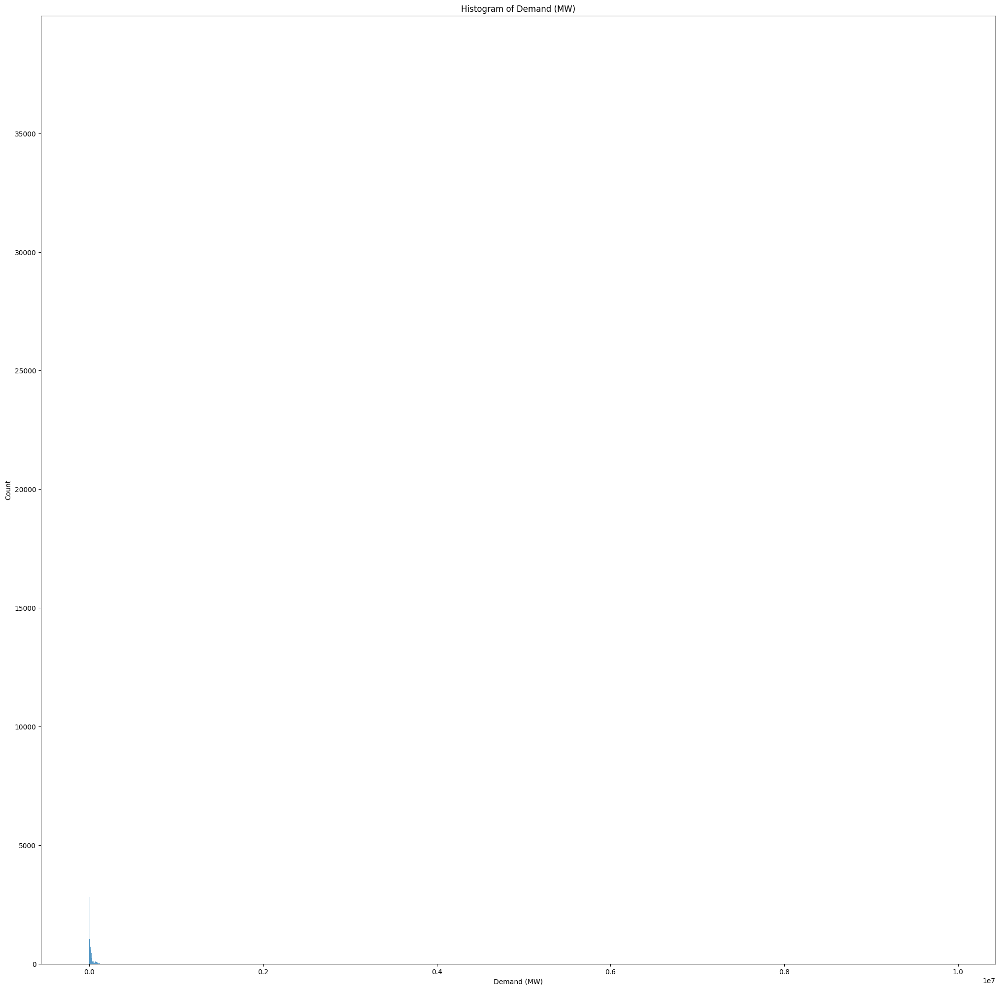

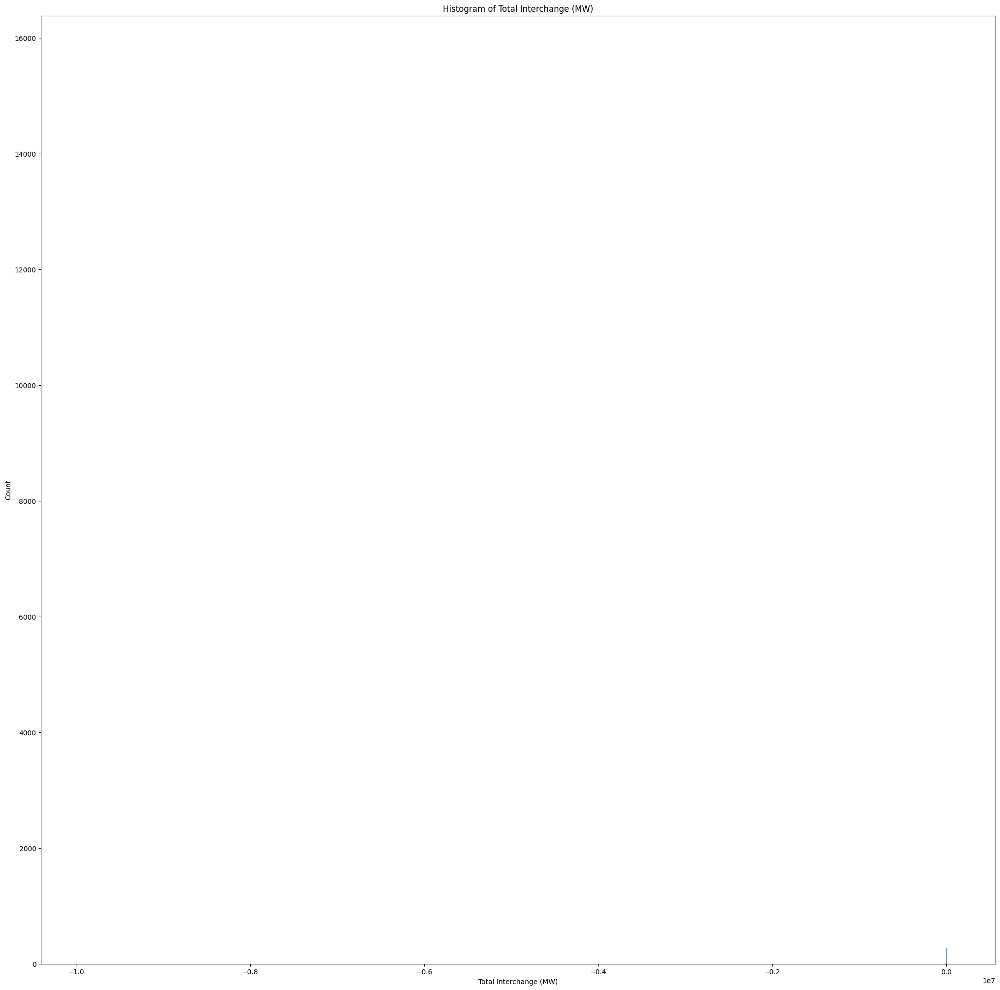

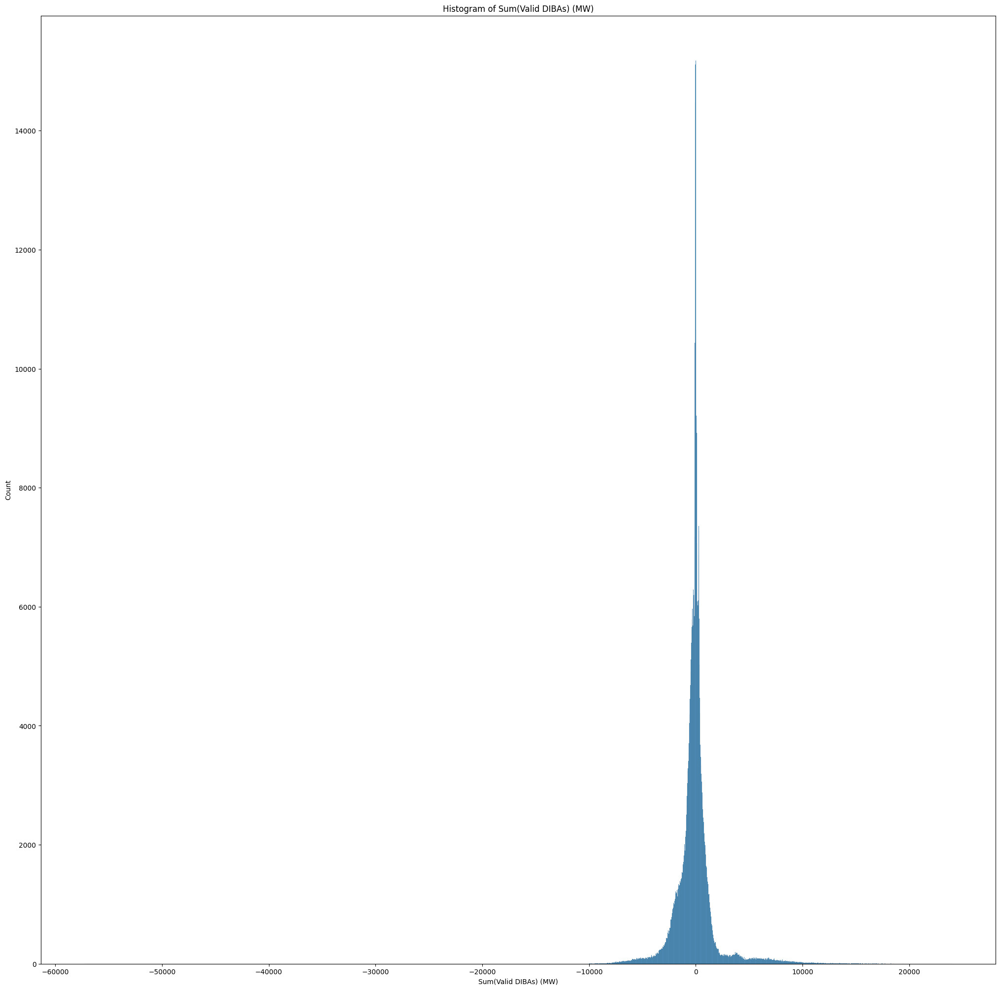

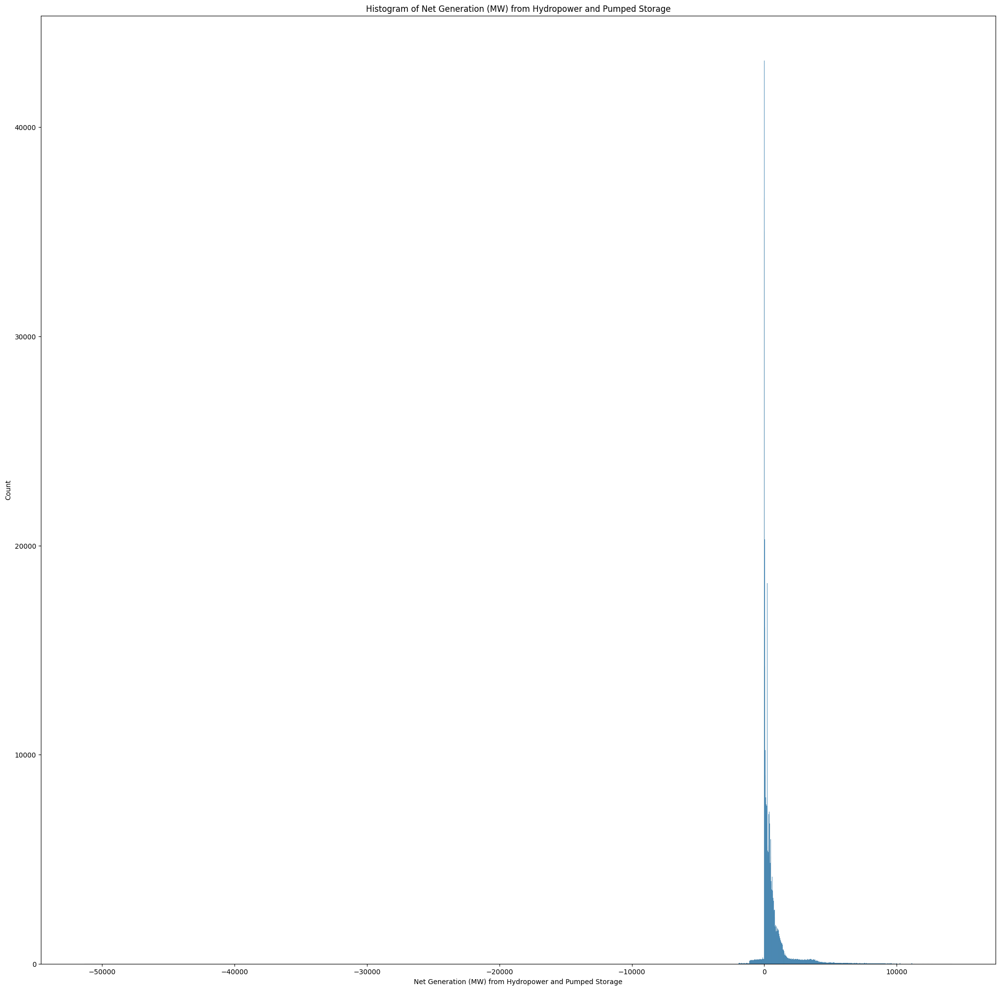

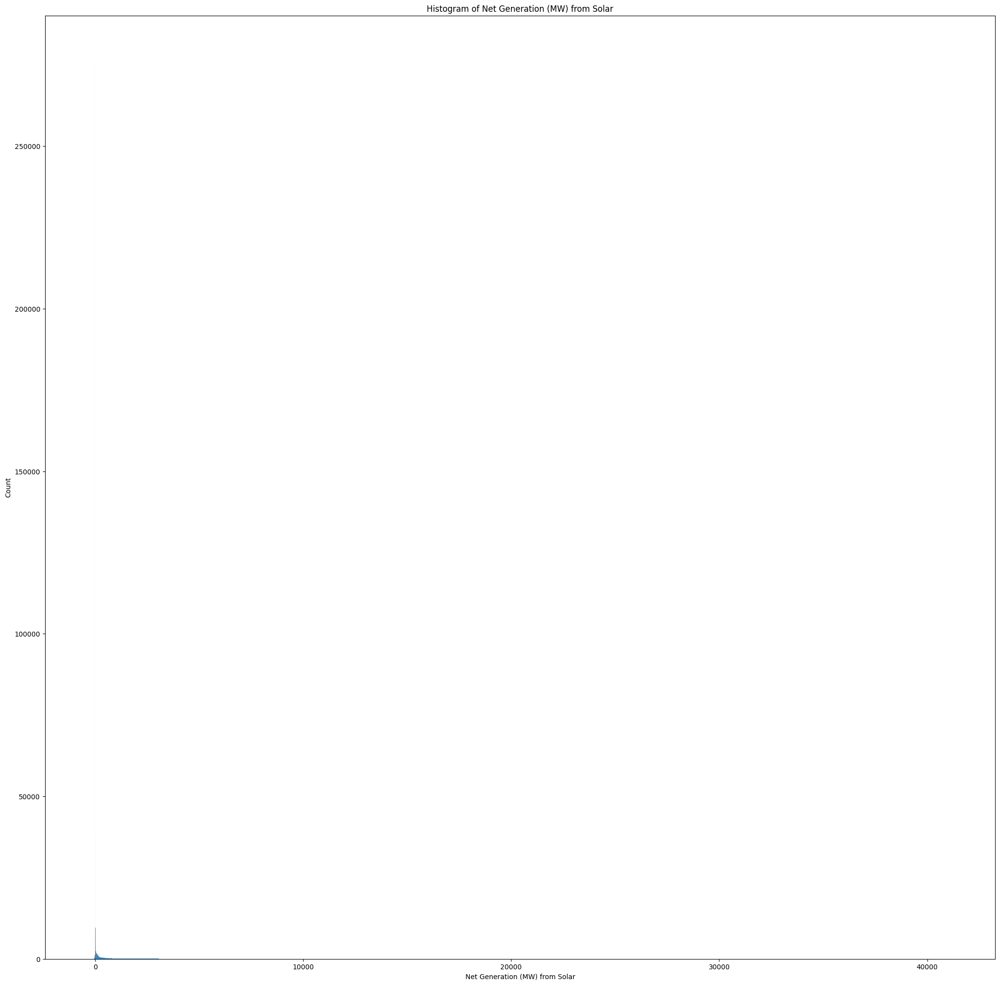

In [69]:
for num_columns in numerical_columns:
    plt.figure(figsize=(25,25))
    sns.histplot(data = df, x = num_columns)
    plt.title(f'Histogram of {num_columns}')
    plt.show()

In [70]:
df['UTC Time at End of Hour'] = pd.to_datetime(df['UTC Time at End of Hour'])
df['Month Name'] = df['UTC Time at End of Hour'].dt.month_name()
df['Week Number'] = df['UTC Time at End of Hour'].dt.isocalendar().week
df['Year'] = df['UTC Time at End of Hour'].dt.year
df['Weekday'] = df['UTC Time at End of Hour'].dt.day_name()


<Axes: xlabel='Weekday', ylabel='Demand (MW)'>

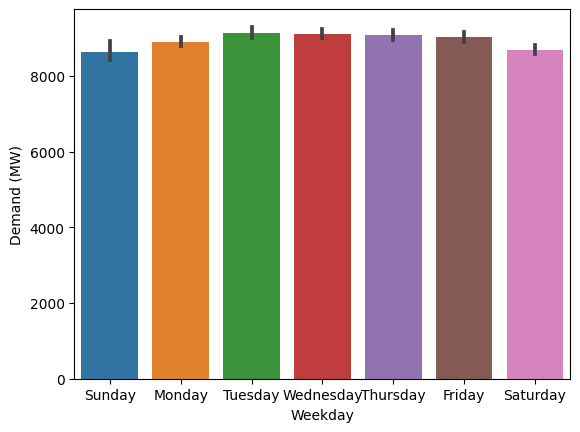

In [71]:
sns.barplot(data = df, x = 'Weekday', y = 'Demand (MW)')

<Axes: xlabel='Month Name', ylabel='Demand (MW)'>

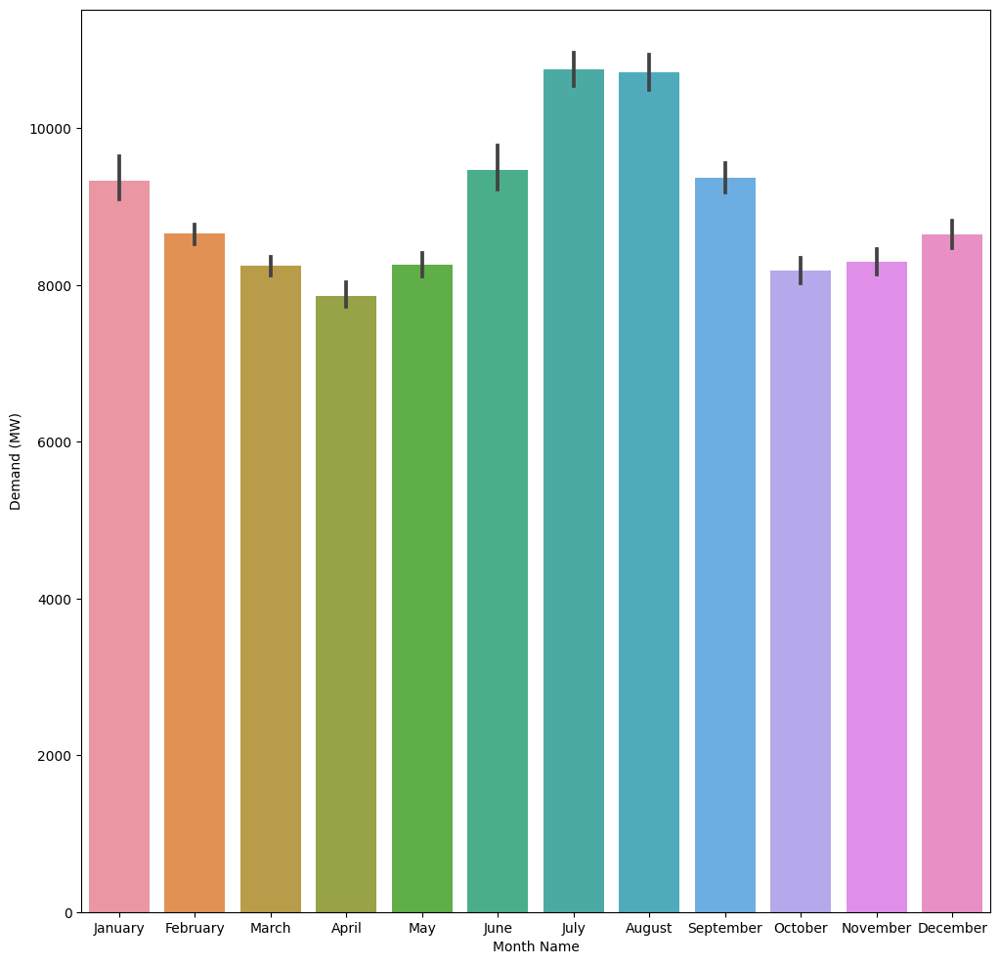

In [72]:
plt.figure(figsize = (12,12))
sns.barplot(data = df, x = 'Month Name', y = 'Demand (MW)')

In [73]:
import numpy as np
for term in range(2):
    df[f'Week_number_sin{term + 1}'] = np.sin(2 * np.pi * df['Week Number']/ df['Week Number'].max())
    df[f'Week_number_cos{term +1}'] = np.cos(2 * np.pi * df['Week Number']/ df['Week Number'].max())
for term in range(2):
    df[f'Hour_Number_sin{term + 1}'] = np.sin(2 * np.pi * df['Hour Number']/ df['Hour Number'].max())
    df[f'Hour_Number_cos{term +1}'] = np.cos(2 * np.pi * df['Hour Number']/ df['Hour Number'].max())
for lag in range(5):
    df[f'Demand_lag{lag +1}'] = df['Demand (MW)'].shift(lag)
df = df.sort_values(by='Balancing Authority')
sixty_day_span = df.groupby(by = 'Balancing Authority')['Demand (MW)'].shift(1).ewm(span= 24*60).mean()
df['ewma_sixty_day_span'] = sixty_day_span
weekly_span = df.groupby(by = 'Balancing Authority')['Demand (MW)'].shift(1).ewm(span= 24*7).mean()
df['ewma_weekly_span'] = weekly_span

In [74]:
daily_span = df.groupby(by = 'Balancing Authority')['Demand (MW)'].shift(1).ewm(span= 24*7).mean()
df['ewma_daily_span'] = daily_span
biweekly_span = df.groupby(by = 'Balancing Authority')['Demand (MW)'].shift(1).ewm(span= 24*14).mean()
df['ewma_biweekly_span'] = biweekly_span
biannual_span = df.groupby(by = 'Balancing Authority')['Demand (MW)'].shift(1).ewm(span= 24*182).mean()
df['ewma_biannual_span'] = biannual_span
hourly_span = df.groupby(by = 'Balancing Authority')['Demand (MW)'].shift(1).ewm(span= 24).mean()
df['ewma_hourly_span'] = hourly_span

In [75]:
df = df.set_index('UTC Time at End of Hour')

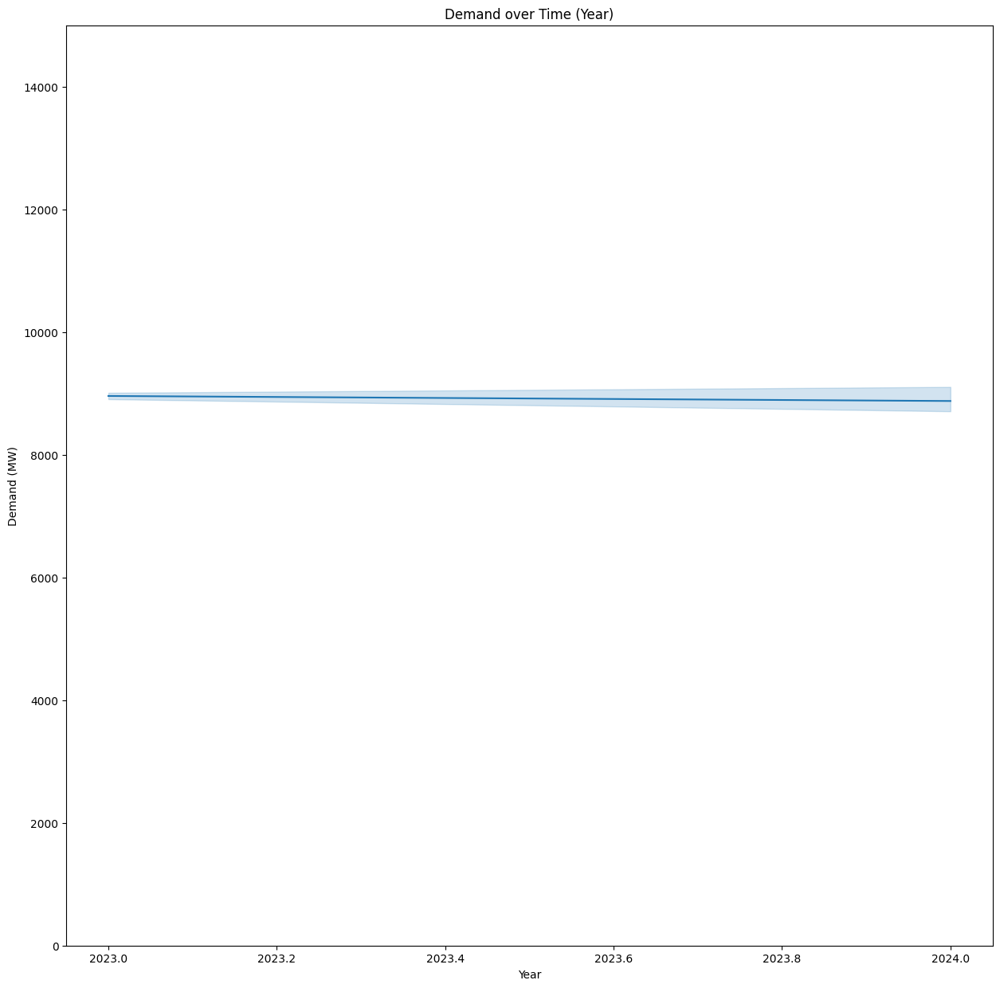

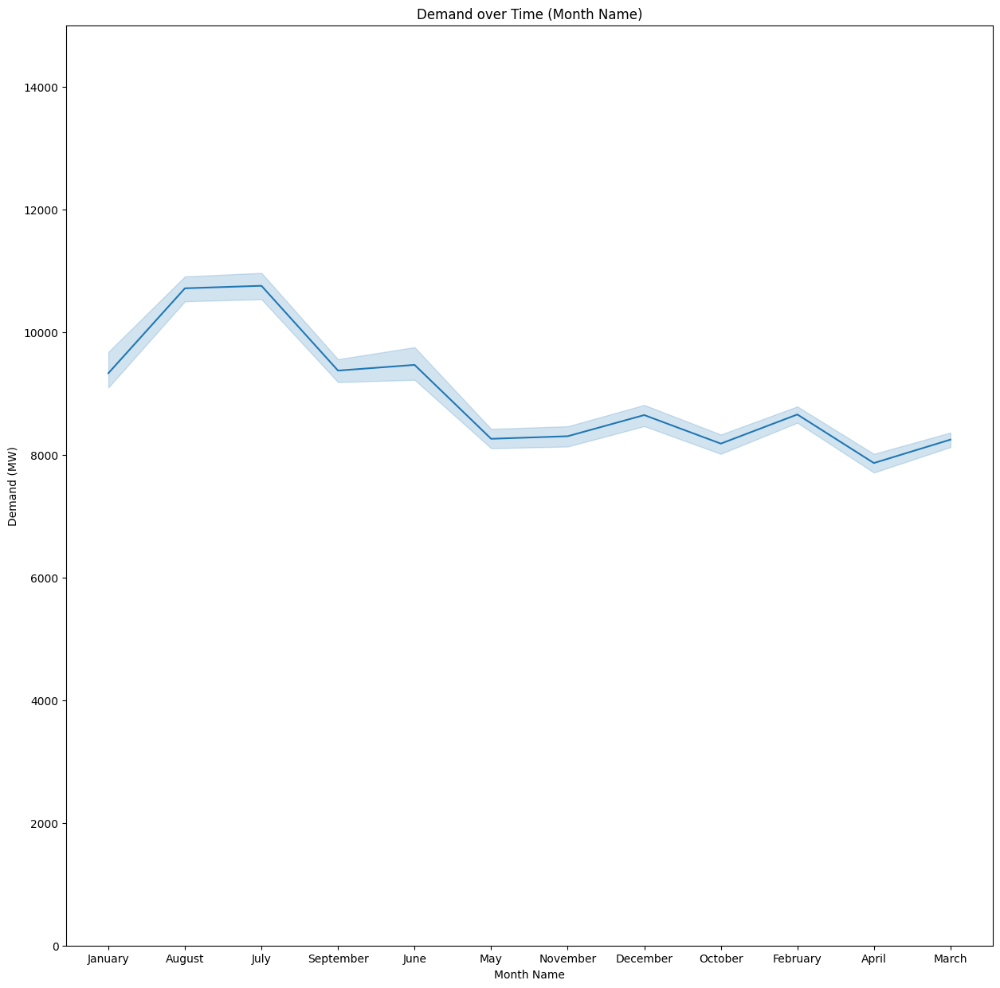

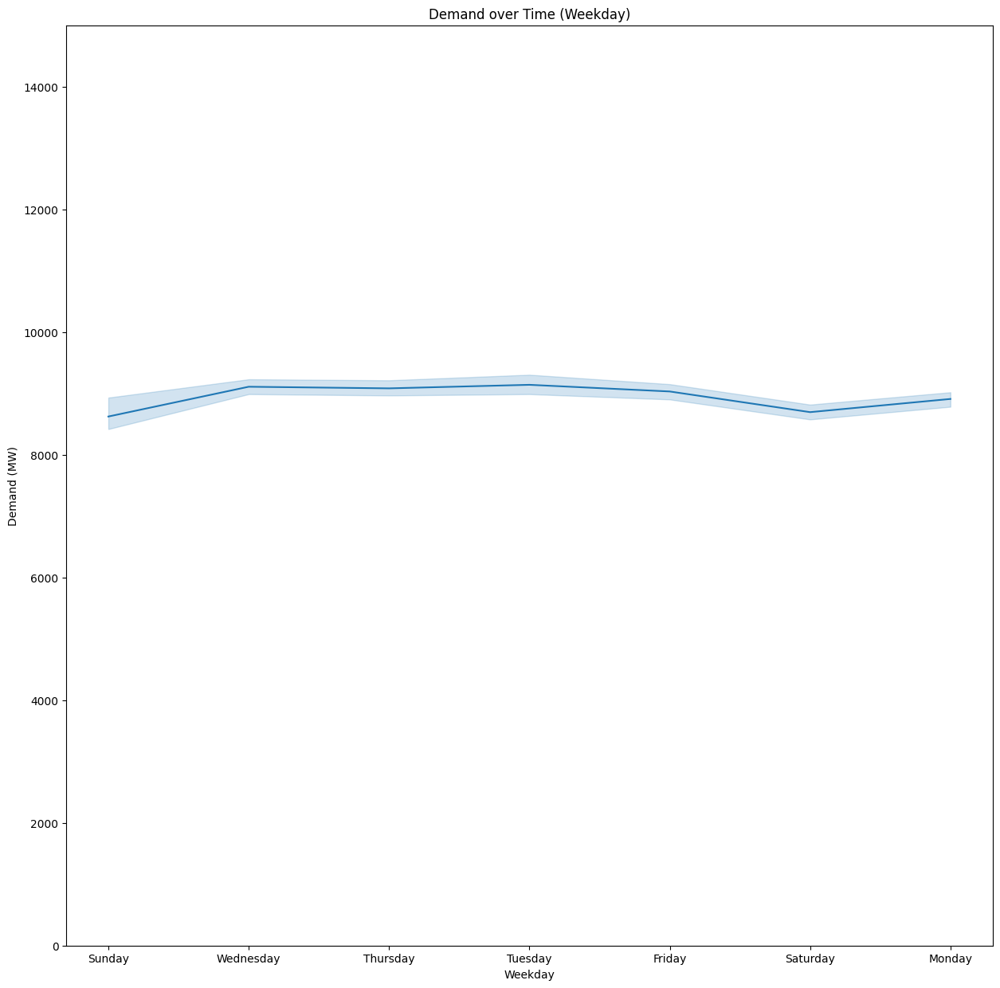

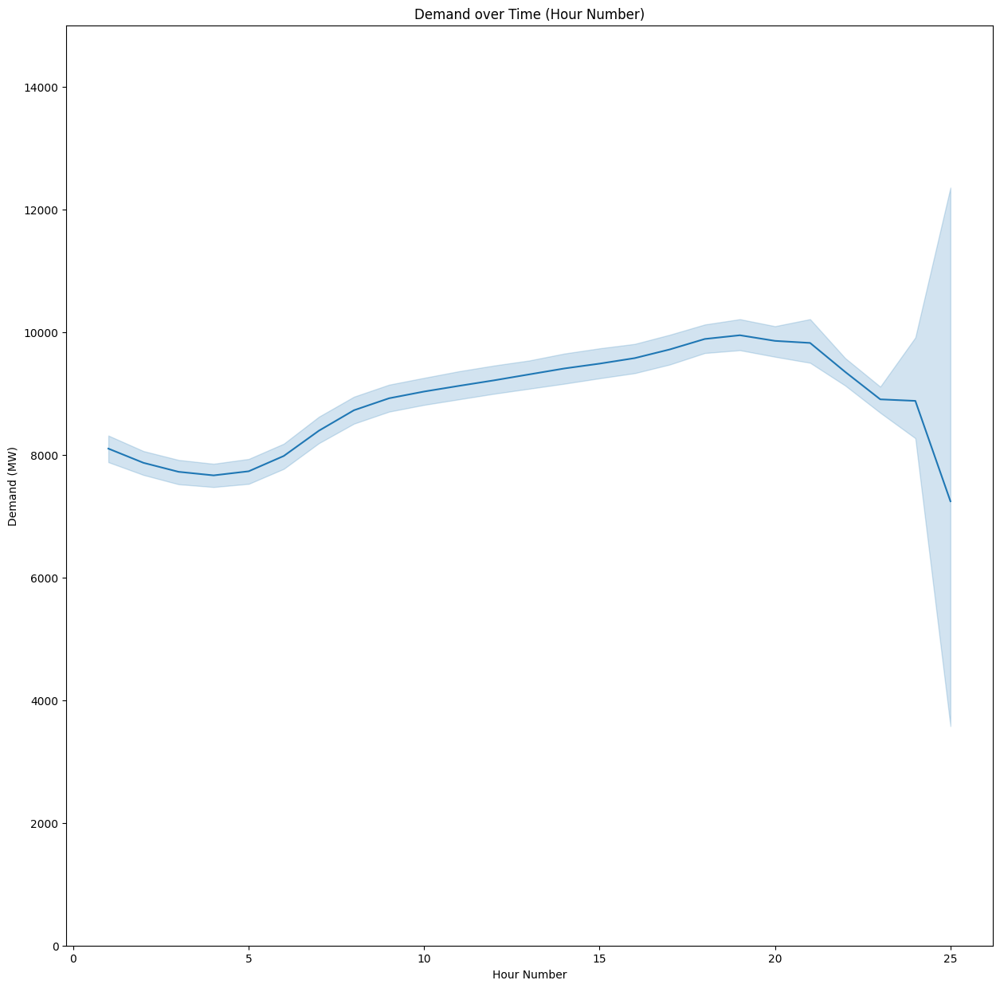

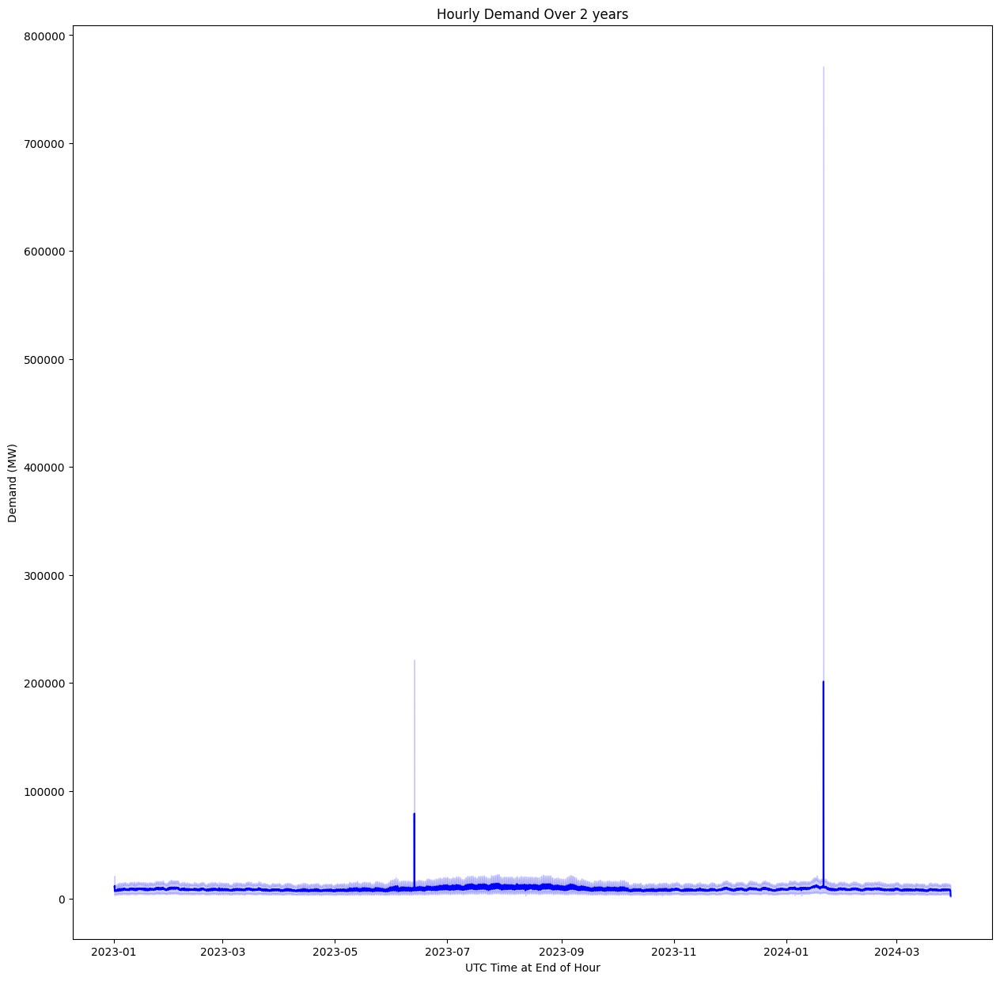

In [76]:
time_features = ['Year', 'Month Name', 'Weekday', 'Hour Number']

for time in time_features:
    plt.figure(figsize = (15,15))
    sns.lineplot(data = df, x = time, y = 'Demand (MW)')
    plt.ylim(0,15000)
    plt.title(f'Demand over Time ({time})')
    plt.show()
plt.figure(figsize=(15,15))
sns.lineplot(df['Demand (MW)'], color = 'blue')
plt.title('Hourly Demand Over 2 years')
plt.show()

In [77]:
df['Monthly Rolling Average for Demand'] = df['Demand (MW)'].rolling(window = 24*30).mean()


<Axes: xlabel='UTC Time at End of Hour', ylabel='Monthly Rolling Average for Demand'>

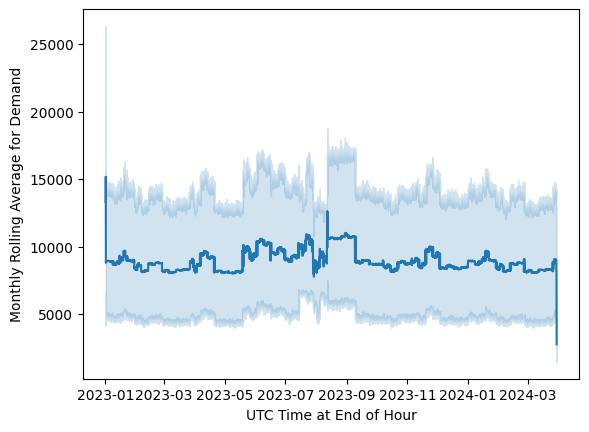

In [78]:
sns.lineplot(data = df['Monthly Rolling Average for Demand'])

In [79]:
from statsmodels.tsa.stattools import adfuller
res = adfuller(df['Demand (MW)'])
print('P-value for Stationary:', res[1])

P-value for Stationary: 5.354957852115871e-13


In [80]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 566549 entries, 2023-01-01 10:00:00 to 2023-12-31 21:00:00
Data columns (total 39 columns):
 #   Column                                                  Non-Null Count   Dtype  
---  ------                                                  --------------   -----  
 0   index                                                   566549 non-null  int64  
 1   Balancing Authority                                     566549 non-null  object 
 2   Data Date                                               566549 non-null  object 
 3   Hour Number                                             566549 non-null  int64  
 4   Local Time at End of Hour                               566549 non-null  object 
 5   Region                                                  566549 non-null  object 
 6   Demand Forecast (MW)                                    566549 non-null  float64
 7   Demand (MW)                                             566549 non-null  flo

In [81]:
df.isnull().sum()

index                                                       0
Balancing Authority                                         0
Data Date                                                   0
Hour Number                                                 0
Local Time at End of Hour                                   0
Region                                                      0
Demand Forecast (MW)                                        0
Demand (MW)                                                 0
Total Interchange (MW)                                      0
Sum(Valid DIBAs) (MW)                                       0
Net Generation (MW) from Hydropower and Pumped Storage      0
Net Generation (MW) from Solar                              0
State_Rep_Region                                            0
Longitude                                                   0
Latitude                                                    0
Month Name                                                  0
Week Num

In [82]:
df = df.dropna()

In [83]:
df.shape

(565827, 39)

In [84]:
df.columns

Index(['index', 'Balancing Authority', 'Data Date', 'Hour Number',
       'Local Time at End of Hour', 'Region', 'Demand Forecast (MW)',
       'Demand (MW)', 'Total Interchange (MW)', 'Sum(Valid DIBAs) (MW)',
       'Net Generation (MW) from Hydropower and Pumped Storage',
       'Net Generation (MW) from Solar', 'State_Rep_Region', 'Longitude',
       'Latitude', 'Month Name', 'Week Number', 'Year', 'Weekday',
       'Week_number_sin1', 'Week_number_cos1', 'Week_number_sin2',
       'Week_number_cos2', 'Hour_Number_sin1', 'Hour_Number_cos1',
       'Hour_Number_sin2', 'Hour_Number_cos2', 'Demand_lag1', 'Demand_lag2',
       'Demand_lag3', 'Demand_lag4', 'Demand_lag5', 'ewma_sixty_day_span',
       'ewma_weekly_span', 'ewma_daily_span', 'ewma_biweekly_span',
       'ewma_biannual_span', 'ewma_hourly_span',
       'Monthly Rolling Average for Demand'],
      dtype='object')

In [85]:
df = df.sort_index()

In [86]:
columns_to_drop = ['index', 'Balancing Authority', 'Data Date', 'Hour Number', 'Local Time at End of Hour', 'Region', 'Demand Forecast (MW)', 
                   'State_Rep_Region', 'Month Name', 'Week Number', 'Year', 'Weekday', 'Monthly Rolling Average for Demand']
ml_df = df.copy()


In [87]:
ml_df.drop(columns_to_drop,axis = 1, inplace = True)


In [88]:
ml_df.shape

(565827, 26)

In [89]:
ml_df.columns

Index(['Demand (MW)', 'Total Interchange (MW)', 'Sum(Valid DIBAs) (MW)',
       'Net Generation (MW) from Hydropower and Pumped Storage',
       'Net Generation (MW) from Solar', 'Longitude', 'Latitude',
       'Week_number_sin1', 'Week_number_cos1', 'Week_number_sin2',
       'Week_number_cos2', 'Hour_Number_sin1', 'Hour_Number_cos1',
       'Hour_Number_sin2', 'Hour_Number_cos2', 'Demand_lag1', 'Demand_lag2',
       'Demand_lag3', 'Demand_lag4', 'Demand_lag5', 'ewma_sixty_day_span',
       'ewma_weekly_span', 'ewma_daily_span', 'ewma_biweekly_span',
       'ewma_biannual_span', 'ewma_hourly_span'],
      dtype='object')

In [90]:
horizon = 1
ml_df['Demand_Shifted'] = ml_df['Demand (MW)'].shift(-horizon)
x = ml_df.drop(['Demand (MW)', 'Demand_Shifted'], axis = 1)
y = ml_df['Demand_Shifted']

In [91]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x = pd.DataFrame(scaler.fit_transform(x), columns=x.columns)



In [92]:
x

,Total Interchange (MW),Sum(Valid DIBAs) (MW),Net Generation (MW) from Hydropower and Pumped Storage,Net Generation (MW) from Solar,Longitude,Latitude,Week_number_sin1,Week_number_cos1,Week_number_sin2,Week_number_cos2,...,Demand_lag2,Demand_lag3,Demand_lag4,Demand_lag5,ewma_sixty_day_span,ewma_weekly_span,ewma_daily_span,ewma_biweekly_span,ewma_biannual_span,ewma_hourly_span
0,-0.077068,-0.559135,-0.514002,-0.311843,1.216828,-0.281396,-0.189239,1.267049,-0.189239,1.267049,...,-0.285711,-0.282256,-0.285091,-0.290408,-0.358988,-0.343679,-0.343679,-0.344219,-0.394271,-0.351694
1,0.013641,0.067183,-0.065486,-0.311843,1.070285,-1.685093,-0.189239,1.267049,-0.189239,1.267049,...,-0.300995,-0.305337,-0.311274,-0.318451,-0.408215,-0.392788,-0.392788,-0.394768,-0.442290,-0.392848
2,0.272746,3.436972,0.443324,-0.305955,1.296086,0.657869,-0.189239,1.267049,-0.189239,1.267049,...,2.954692,2.936174,2.948446,2.935288,4.988232,4.637309,4.637309,4.794477,5.153774,4.049517
3,-0.173724,-1.230376,1.687000,-0.311843,1.521027,0.612252,-0.189239,1.267049,-0.189239,1.267049,...,0.249675,0.244048,0.239485,0.227302,0.477921,0.436545,0.436545,0.455014,0.480118,0.353179
4,0.004533,0.007633,-0.503836,-0.312579,1.216828,-0.281396,-0.189239,1.267049,-0.189239,1.267049,...,-0.162331,-0.164015,-0.166762,-0.184837,-0.127172,-0.122635,-0.122635,-0.116448,-0.107302,-0.166951
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
565822,-0.084395,-0.609978,-0.474184,-0.310862,-0.897046,1.132159,1.242439,-0.176853,1.242439,-0.176853,...,-0.287139,-0.284397,-0.281656,-0.278914,-0.348206,-0.343173,-0.343173,-0.344926,-0.380187,-0.348786
565823,-0.019614,-0.160453,-0.414316,-0.311843,-0.897046,1.132159,1.242439,-0.176853,1.242439,-0.176853,...,-0.374187,-0.373768,-0.373350,-0.372932,-0.498385,-0.478879,-0.478879,-0.482098,-0.548084,-0.472474
565824,-0.039354,-0.297429,-0.276977,-0.311287,-0.897046,1.132159,1.242439,-0.176853,1.242439,-0.176853,...,-0.354576,-0.353345,-0.352115,-0.350884,-0.463316,-0.446535,-0.446535,-0.449626,-0.507471,-0.443293
565825,-0.029953,-0.232191,-0.288932,-0.311843,-0.897046,1.132159,1.242439,-0.176853,1.242439,-0.176853,...,-0.338307,-0.337160,-0.336014,-0.334867,-0.440492,-0.426262,-0.426262,-0.429197,-0.481588,-0.423662


In [93]:
y = y.dropna()

In [94]:
split_length = int(len(ml_df)*.8)
x_train = x[:split_length]
y_train = y[:split_length]
x_test = x[split_length:]
y_test = y[split_length:]

In [95]:
print(x_train.shape, '\n', y_train.shape, '\n', x_test.shape, '\n', y_test.shape)

(452661, 25) 
 (452661,) 
 (113166, 25) 
 (113165,)


In [96]:
from lightgbm import LGBMRegressor
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit
param_lgbm = {'min_child_weight': [1,3,5,7], 'max_depth': [5,8,15], 'n_estimators': [300,500,800]}

tscv = TimeSeriesSplit(n_splits=8)
grid_search_lgbm = GridSearchCV(LGBMRegressor(), param_grid=param_lgbm, scoring = 'neg_mean_absolute_error', cv = tscv)
grid_search_lgbm.fit(x_train, y_train)
print('Grid Search RSME:', round(grid_search_lgbm.best_score_, 3))
print('Best Parameters:', grid_search_lgbm.best_params_)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001915 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3979
[LightGBM] [Info] Number of data points in the train set: 50301, number of used features: 25
[LightGBM] [Info] Start training from score 8870.582358
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

In [97]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
model_dict = {}
demand_forecast_rmse = np.sqrt(mean_squared_error(df['Demand (MW)'].values[split_length:], df['Demand Forecast (MW)'].values[split_length:]))
demand_forecast_mae = mean_absolute_error(df['Demand (MW)'].values[split_length:], df['Demand Forecast (MW)'].values[split_length:])
lgbm_model = grid_search_lgbm.best_estimator_.fit(x_train, y_train)
lgbm_predictions = lgbm_model.predict(x_test)
lgbm_rmse = np.sqrt(mean_squared_error(ml_df['Demand (MW)'].values[split_length:], lgbm_predictions))
lgbm_mae = mean_absolute_error(ml_df['Demand (MW)'].values[split_length:], lgbm_predictions)
model_dict['Demand Forecast'] = [demand_forecast_rmse, demand_forecast_mae]
model_dict['LGBM'] = [lgbm_rmse, lgbm_mae]




[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004021 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4119
[LightGBM] [Info] Number of data points in the train set: 452661, number of used features: 25
[LightGBM] [Info] Start training from score 8968.596183
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Ligh

In [98]:
model_dict

{'Demand Forecast': [29451.172960623655, 441.6053633370231],
 'LGBM': [34467.34534172504, 10539.638434012313]}

In [99]:
import tensorflow
sequence_length = 168

In [100]:
def create_dataset(x, y, sequence_length, batch_size):
    dataset = tensorflow.data.Dataset.from_tensor_slices((x, y))
    dataset = dataset.window(sequence_length+1, shift=1, drop_remainder=True)
    dataset = dataset.flat_map(lambda x, y: tensorflow.data.Dataset.zip((x.batch(sequence_length+1), y.batch(sequence_length + 1))))
    dataset = dataset.map(lambda x, y: (x[:-1], tensorflow.squeeze(y[-1:], axis = -1)))
    dataset = dataset.batch(batch_size).prefetch(tensorflow.data.AUTOTUNE)
    return dataset


In [101]:
train_dataset = create_dataset(x_train, y_train, sequence_length=sequence_length,batch_size=512)

In [102]:
import tensorflow

In [103]:
from tensorflow.keras.layers import Dense, LSTM, Conv1D, MaxPooling1D, Dropout
from tensorflow.keras import Model, Input
from tensorflow.keras.metrics import RootMeanSquaredError, MeanAbsoluteError
from tensorflow.keras.losses import Huber

lstm_input = Input(shape = [None, x_train.shape[1]])
lstm_x = LSTM(64, return_sequences = True)(lstm_input)
lstm_x = LSTM(32)(lstm_x)
lstm_x = Dropout(0.3)(lstm_x)
lstm_x= Dense(128, activation = 'relu')(lstm_x)
lstm_x = Dropout(0.2)(lstm_x)
lstm_output = Dense(1)(lstm_x)

lstm_model = Model(lstm_input, lstm_output)
lstm_model.compile(optimizer = 'adam', loss = Huber(), metrics = [RootMeanSquaredError(), MeanAbsoluteError()])
lstm_model.summary()




Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, None, 25)]        0         
                                                                 
 lstm (LSTM)                 (None, None, 64)          23040     
                                                                 
 lstm_1 (LSTM)               (None, 32)                12416     
                                                                 
 dropout (Dropout)           (None, 32)                0         
                                                                 
 dense (Dense)               (None, 128)               4224      
                                                                 
 dropout_1 (Dropout)         (None, 128)               0         
                                                                 
 dense_1 (Dense)             (None, 1)                 129 

In [104]:
lstm_model.fit(train_dataset, epochs = 10, shuffle=False)

Epoch 1/10

884/884 [==============================] - 281s 316ms/step - loss: 8383.5771 - root_mean_squared_error: 20145.3496 - mean_absolute_error: 8384.0781
Epoch 2/10
884/884 [==============================] - 255s 289ms/step - loss: 7957.0190 - root_mean_squared_error: 19624.4375 - mean_absolute_error: 7957.5186
Epoch 3/10
884/884 [==============================] - 261s 296ms/step - loss: 7954.7852 - root_mean_squared_error: 19610.7441 - mean_absolute_error: 7955.2856
Epoch 4/10
884/884 [==============================] - 262s 296ms/step - loss: 7954.9517 - root_mean_squared_error: 19610.2891 - mean_absolute_error: 7955.4517
Epoch 5/10
884/884 [==============================] - 256s 290ms/step - loss: 7952.7837 - root_mean_squared_error: 19614.2812 - mean_absolute_error: 7953.2837
Epoch 6/10
884/884 [==============================] - 257s 290ms/step - loss: 7939.2729 - root_mean_squared_error: 19599.6309 - mean_absolute_error: 7939.7729
Epoch 7/10
884/884 [=========================

In [105]:
lstm_model_pred = lstm_model.predict(np.expand_dims(x_test, axis = 1))

lstm_rmse = np.sqrt(mean_squared_error(ml_df['Demand (MW)'].values[split_length:], lstm_model_pred))
lstm_mae = mean_absolute_error(ml_df['Demand (MW)'].values[split_length:], lstm_model_pred)

model_dict['LSTM'] = [lstm_rmse, lstm_mae]



3537/3537 [==============================] - 3s 645us/step


In [106]:
cnn_lstm_input = Input(shape = [None, x_train.shape[1]])
padding = tensorflow.constant([[0,0], [5,0], [0,0]])
padding_input = tensorflow.pad(cnn_lstm_input, padding, 'CONSTANT')
cnn_x = Conv1D(filters = 100, kernel_size = 3, activation = 'relu', padding = 'same')(padding_input)
max_pool_x = MaxPooling1D(2)(cnn_x)
cnn_lstm_x = LSTM(64, return_sequences = True)(max_pool_x)
cnn_lstm_x = LSTM(32)(cnn_lstm_x)
cnn_lstm_x = Dropout(0.3)(cnn_lstm_x)
cnn_lstm_x= Dense(128, activation = 'relu')(cnn_lstm_x)
cnn_lstm_x = Dropout(0.2)(cnn_lstm_x)
cnn_lstm_output = Dense(1)(cnn_lstm_x)

cnn_lstm_model = Model(cnn_lstm_input, cnn_lstm_output)
cnn_lstm_model.compile(optimizer = 'adam', loss = Huber(), metrics = [RootMeanSquaredError(), MeanAbsoluteError()])
cnn_lstm_model.summary()


Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, None, 25)]        0         
                                                                 
 tf.compat.v1.pad (TFOpLamb  (None, None, 25)          0         
 da)                                                             
                                                                 
 conv1d (Conv1D)             (None, None, 100)         7600      
                                                                 
 max_pooling1d (MaxPooling1  (None, None, 100)         0         
 D)                                                              
                                                                 
 lstm_2 (LSTM)               (None, None, 64)          42240     
                                                                 
 lstm_3 (LSTM)               (None, 32)                124

In [107]:
cnn_lstm_model.fit(train_dataset, epochs = 10, shuffle=False)

Epoch 1/10
884/884 [==============================] - 144s 161ms/step - loss: 8370.7617 - root_mean_squared_error: 20127.3086 - mean_absolute_error: 8371.2617
Epoch 2/10
884/884 [==============================] - 146s 165ms/step - loss: 7956.2290 - root_mean_squared_error: 19620.5469 - mean_absolute_error: 7956.7300
Epoch 3/10
884/884 [==============================] - 146s 165ms/step - loss: 7953.2017 - root_mean_squared_error: 19615.2441 - mean_absolute_error: 7953.7017
Epoch 4/10
884/884 [==============================] - 148s 168ms/step - loss: 7942.4634 - root_mean_squared_error: 19608.3906 - mean_absolute_error: 7942.9629
Epoch 5/10
884/884 [==============================] - 147s 166ms/step - loss: 7937.9443 - root_mean_squared_error: 19589.5879 - mean_absolute_error: 7938.4448
Epoch 6/10
884/884 [==============================] - 147s 166ms/step - loss: 7935.5728 - root_mean_squared_error: 19580.9844 - mean_absolute_error: 7936.0723
Epoch 7/10
884/884 [==========================

In [108]:
cnn_lstm_model_pred = cnn_lstm_model.predict(np.expand_dims(x_test, axis = 1))



3537/3537 [==============================] - 5s 1ms/step


In [109]:

cnn_lstm_rmse = np.sqrt(mean_squared_error(ml_df['Demand (MW)'].values[split_length:], cnn_lstm_model_pred))


In [110]:
cnn_lstm_mae = mean_absolute_error(ml_df['Demand (MW)'].values[split_length:], cnn_lstm_model_pred)

model_dict['CNN-LSTM'] = [cnn_lstm_rmse, cnn_lstm_mae]


In [111]:
model_dict

{'Demand Forecast': [29451.172960623655, 441.6053633370231],
 'LGBM': [34467.34534172504, 10539.638434012313],
 'LSTM': [35336.000396059455, 8511.950062075388],
 'CNN-LSTM': [35148.83784458103, 8177.6353499816005]}

In [112]:
pred_train_dict = {}
lgbm_train_predictions = lgbm_model.predict(x_train)
lstm_model_train_predictions = lstm_model.predict(np.expand_dims(x_train, axis = 1))
cnn_lstm_model_train_predictions = cnn_lstm_model.predict(np.expand_dims(x_train, axis = 1))
pred_train_dict['LGBM'] = list(np.array(lgbm_train_predictions).flatten())
pred_train_dict['LSTM'] = list(np.array(lstm_model_train_predictions).flatten())
pred_train_dict['CNN-LSTM'] = list(np.array(cnn_lstm_model_train_predictions).flatten())
pred_train_dict

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
14146/14146 [==============================] - 18s 1ms/step


{'LGBM': [7867.504959235723,
  8543.417335205057,
  6855.757980533505,
  7286.512539879379,
  7858.390018529752,
  7643.319273108775,
  8694.329250893317,
  7651.138997300412,
  9176.097898746773,
  5190.635653947972,
  7385.940282312932,
  8624.713551092846,
  7488.155952250505,
  7829.610965018472,
  7834.202634640762,
  7032.548950481319,
  9006.359419692884,
  7179.885721842602,
  11041.264719965147,
  8252.535468523341,
  6466.670798034019,
  7445.049002926302,
  7425.616048685934,
  6339.022844592895,
  10914.824659372416,
  7244.059418720934,
  9170.320755575087,
  6556.822805431129,
  7582.858546912921,
  8639.404866556457,
  7824.832367423133,
  8842.250584752534,
  7709.867053475922,
  9189.512998683498,
  4501.6885371750805,
  8543.417335205057,
  8970.51435133116,
  10890.53193500768,
  7497.1344124701955,
  7685.043257050985,
  6892.271928134319,
  7589.032742667677,
  7443.265768925935,
  7643.319273108775,
  7990.703034942366,
  7636.105168091413,
  7997.2934863991095,
 

In [113]:
pred_train_df = pd.DataFrame(pred_train_dict, index = y_train.index)

In [114]:
pred_train_df

,LGBM,LSTM,CNN-LSTM
UTC Time at End of Hour,,,
2023-01-01 06:00:00,7867.504959,478.938385,1527.535034
2023-01-01 06:00:00,8543.417335,488.664825,1950.859985
2023-01-01 06:00:00,6855.757981,428.833405,1189.548096
2023-01-01 06:00:00,7286.512540,305.597870,1177.275269
2023-01-01 06:00:00,7858.390019,413.197479,1253.288696
...,...,...,...
2023-12-30 14:00:00,9630.158270,477.132843,1878.191772
2023-12-30 14:00:00,8254.764713,634.090576,2059.780029
2023-12-30 14:00:00,11234.409018,288.619812,1315.964478


In [115]:
pred_test_dict = {}
pred_test_dict['LGBM'] = list(np.array(lgbm_predictions).flatten())
pred_test_dict['LSTM'] = list(np.array(lstm_model_pred).flatten())
pred_test_dict['CNN-LSTM'] = list(np.array(cnn_lstm_model_pred).flatten())
pred_test_dict


{'LGBM': [9265.015015936118,
  7918.474126708899,
  10131.39200226977,
  8332.21159068281,
  8938.423115699472,
  7949.578878302936,
  8535.500713245796,
  8516.472200068843,
  8112.014721983,
  8329.965058861952,
  8465.552362147602,
  8743.842844361952,
  9182.149691428767,
  8978.725900314286,
  8978.754621936952,
  7683.6377458326315,
  8389.426678956906,
  9267.536042910871,
  8826.274726998752,
  8404.731000503509,
  8208.99366729905,
  8004.551654124688,
  9226.220145996609,
  8373.82938588162,
  10499.965533518209,
  7753.698543040978,
  8342.775967230798,
  8787.58155525841,
  9184.078669974766,
  7980.605410450651,
  9911.43012384654,
  7947.681192272022,
  8001.097230838626,
  8087.6732225261085,
  7366.122079521628,
  8146.604333703621,
  9192.002455157859,
  7835.125868287254,
  9476.804002089411,
  8692.058686921355,
  8094.672225874874,
  8226.889491238566,
  8140.582641383017,
  7538.170418303551,
  9404.46593871467,
  8223.76365650157,
  9826.494620570405,
  8358.97977

In [116]:
pred_test_df = pd.DataFrame(pred_test_dict, index = ml_df['Demand (MW)'][split_length:].index)

In [119]:
from sklearn.linear_model import HuberRegressor
param_huber = {'epsilon': np.linspace(1,2,10), 'alpha': [0.001, 0.01, 0.05, 0.07, 1, 5, 10]}
grid_search_huber = GridSearchCV(estimator=HuberRegressor(), param_grid=param_huber, scoring='neg_mean_absolute_error', cv=tscv)
grid_search_huber.fit(pred_train_df.values, y_train.values)
from sklearn.linear_model import HuberRegressor
stacking_huber = grid_search_huber.best_estimator_
stacking_huber.fit(pred_train_df.values, y_train.values)

HuberRegressor(alpha=10, epsilon=1.0)

In [120]:
huber_train_rmse = np.sqrt(mean_squared_error(y_train, stacking_huber.predict(pred_train_df.values)))
huber_train_mae = mean_absolute_error(y_train, stacking_huber.predict(pred_train_df.values))
print('Huber loss rmse:', huber_train_rmse, '\n', 'Huber loss mae:', huber_train_mae)

Huber loss rmse: 19474.466389991634 
 Huber loss mae: 7913.756476895135


In [121]:
pd.DataFrame({"Model": pred_train_df.columns, "Weights": stacking_huber.coef_}).round(
    4
).sort_values("Weights", ascending=False)

,Model,Weights
1,LSTM,0.9003
0,LGBM,0.2927
2,CNN-LSTM,-0.2829


In [122]:
stacking_predictions = stacking_huber.predict(pred_test_df.values)
stacking_rmse = np.sqrt(mean_squared_error(ml_df['Demand (MW)'].values[split_length:], stacking_predictions))
stacking_mae = mean_absolute_error(ml_df['Demand (MW)'].values[split_length:], stacking_predictions)


In [123]:
model_dict['Huber LGBM+LSTM+CNN-LSTM'] = [stacking_rmse, stacking_mae]

In [124]:
model_dict

{'Demand Forecast': [29451.172960623655, 441.6053633370231],
 'LGBM': [34467.34534172504, 10539.638434012313],
 'LSTM': [35336.000396059455, 8511.950062075388],
 'CNN-LSTM': [35148.83784458103, 8177.6353499816005],
 'Huber LGBM+LSTM+CNN-LSTM': [34931.65515426537, 7920.286376119671]}

In [126]:
from sklearn.linear_model import Ridge
ridge_param = {'alpha': [0.001, 0.01, 0.05, 0.07, 1, 5, 10]}
grid_search_ridge = GridSearchCV(estimator=Ridge(), param_grid=ridge_param, scoring='neg_mean_absolute_error', cv=tscv)
grid_search_ridge.fit(pred_train_df.values, y_train.values)
stacking_ridge = grid_search_ridge.best_estimator_
stacking_ridge.fit(pred_train_df.values, y_train.values)
ridge_train_rmse = np.sqrt(mean_squared_error(y_train, stacking_ridge.predict(pred_train_df.values)))
ridge_train_mae = mean_absolute_error(y_train, stacking_ridge.predict(pred_train_df.values))
print('Huber loss rmse:', ridge_train_rmse, '\n', 'Huber loss mae:', ridge_train_mae)
ridge_stacking_predictions = stacking_ridge.predict(pred_test_df.values)
ridge_stacking_rmse = np.sqrt(mean_squared_error(ml_df['Demand (MW)'].values[split_length:], ridge_stacking_predictions))
ridge_stacking_mae = mean_absolute_error(ml_df['Demand (MW)'].values[split_length:], ridge_stacking_predictions)
print(pd.DataFrame({"Model": pred_train_df.columns, "Weights": stacking_ridge.coef_}).round(
    4
).sort_values("Weights", ascending=False))
model_dict['Ridge LGBM+LSTM+CNN-LSTM'] = [ridge_stacking_rmse, ridge_stacking_mae]

Huber loss rmse: 18014.88055679735 
 Huber loss mae: 10422.344652993927
      Model  Weights
1      LSTM   5.8491
0      LGBM   2.3191
2  CNN-LSTM  -2.7641


In [127]:
model_dict

{'Demand Forecast': [29451.172960623655, 441.6053633370231],
 'LGBM': [34467.34534172504, 10539.638434012313],
 'LSTM': [35336.000396059455, 8511.950062075388],
 'CNN-LSTM': [35148.83784458103, 8177.6353499816005],
 'Huber LGBM+LSTM+CNN-LSTM': [34931.65515426537, 7920.286376119671],
 'Ridge LGBM+LSTM+CNN-LSTM': [34617.397306956525, 10568.904930552375]}

In [128]:
from xgboost import XGBRegressor
xg_param = {'eta': [0.01, 0.015, 0.025, 0.025, 0.05, 0.1], 'gamma': [0.05, 0.3, 0.5, 0.7, 0.9], 'min_child_weight': [1,3,5,7], 'max_depth': [5,8,15]}
grid_search_xg = GridSearchCV(estimator=XGBRegressor(), param_grid=xg_param, scoring='neg_mean_absolute_error', cv=tscv)
grid_search_xg.fit(pred_train_df.values, y_train.values)
stacking_xg = grid_search_xg.best_estimator_
stacking_xg.fit(pred_train_df.values, y_train.values)
xg_train_rmse = np.sqrt(mean_squared_error(y_train, stacking_xg.predict(pred_train_df.values)))
xg_train_mae = mean_absolute_error(y_train, stacking_xg.predict(pred_train_df.values))
print('XGBoost loss rmse:', xg_train_rmse, '\n', 'XGBoost loss mae:', xg_train_mae)
xg_stacking_predictions = stacking_xg.predict(pred_test_df.values)
xg_stacking_rmse = np.sqrt(mean_squared_error(ml_df['Demand (MW)'].values[split_length:], xg_stacking_predictions))
xg_stacking_mae = mean_absolute_error(ml_df['Demand (MW)'].values[split_length:], xg_stacking_predictions)
model_dict['XGBoost LGBM+LSTM+CNN-LSTM'] = [xg_stacking_rmse, xg_stacking_mae]

XGBoost loss rmse: 18178.394930621373 
 XGBoost loss mae: 10458.343303427157


In [129]:
model_dict

{'Demand Forecast': [29451.172960623655, 441.6053633370231],
 'LGBM': [34467.34534172504, 10539.638434012313],
 'LSTM': [35336.000396059455, 8511.950062075388],
 'CNN-LSTM': [35148.83784458103, 8177.6353499816005],
 'Huber LGBM+LSTM+CNN-LSTM': [34931.65515426537, 7920.286376119671],
 'Ridge LGBM+LSTM+CNN-LSTM': [34617.397306956525, 10568.904930552375],
 'XGBoost LGBM+LSTM+CNN-LSTM': [34466.45866445886, 10517.003197233968]}

In [130]:
low_demand_threshold = np.percentile(df['Demand (MW)'][:split_length],25)
high_demand_threshold = np.percentile(df['Demand (MW)'][:split_length], 75)

In [131]:
single_eval_dict = pred_test_dict.copy()
single_eval_dict['Demand Forecast'] = df['Demand Forecast (MW)'].values[split_length:]
single_eval_dict['Huber LGBM+LSTM+CNN-LSTM'] = stacking_predictions
single_eval_dict['Ridge LGBM+LSTM+CNN-LSTM'] = ridge_stacking_predictions
single_eval_dict['XGBoost LGBM+LSTM+CNN-LSTM'] = xg_stacking_predictions
single_eval_dict['actual'] = ml_df['Demand (MW)'].values[split_length:]
single_eval_df = pd.DataFrame(single_eval_dict, index=ml_df['Demand (MW)'][split_length:].index)


<Axes: >

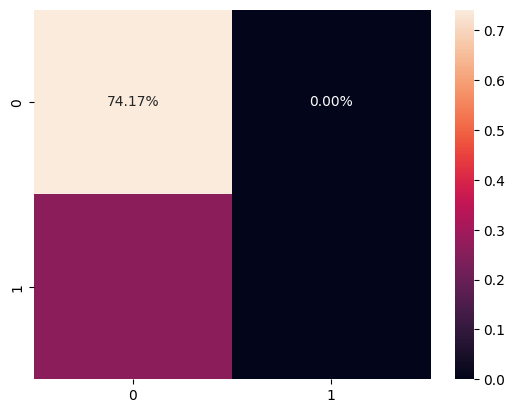

In [149]:
actual_low_demand_percentile = np.where(single_eval_df['actual'] <= low_demand_threshold, 1,0)
predicted_low_demand_perecentile = np.where(single_eval_df['LGBM'] <= low_demand_threshold, 1,0)
actual_high_demand_percentile = np.where(single_eval_df['actual'] >= high_demand_threshold, 1,0)
predicted_high_demand_percentile = np.where(single_eval_df['LGBM']>= high_demand_threshold, 1,0)
low_demand_confusion_matrix = confusion_matrix(actual_low_demand_percentile, predicted_low_demand_perecentile)
sns.heatmap(low_demand_confusion_matrix/np.sum(low_demand_confusion_matrix), annot = True, fmt = '.2%')

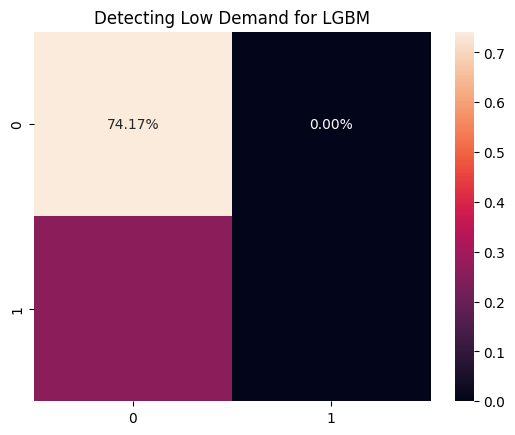

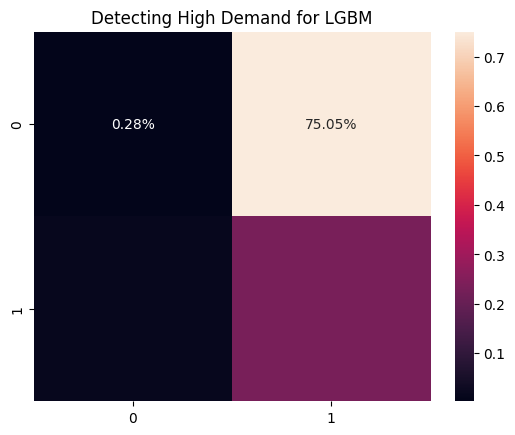

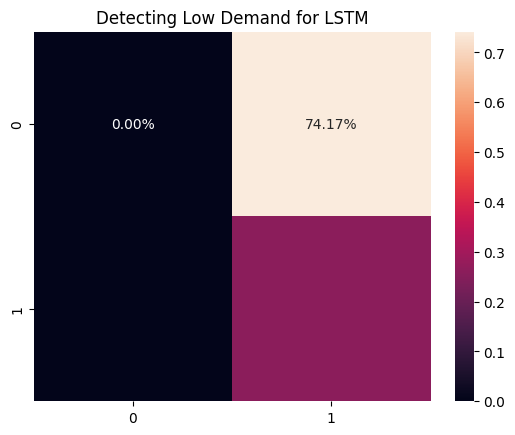

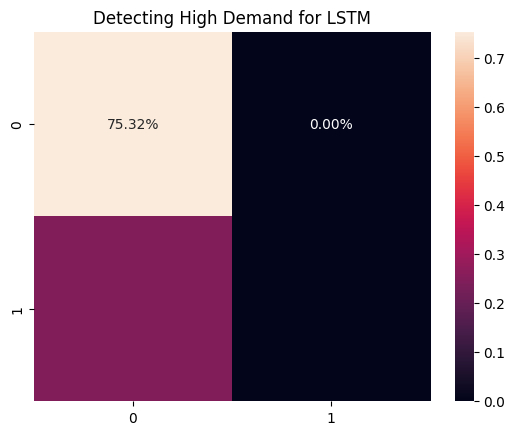

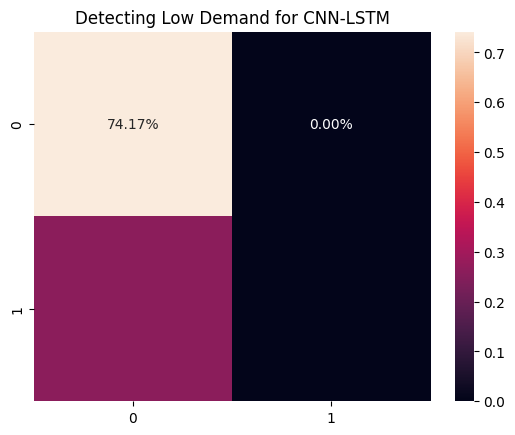

...

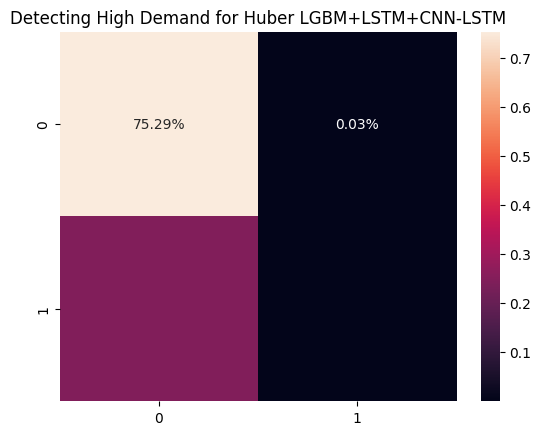

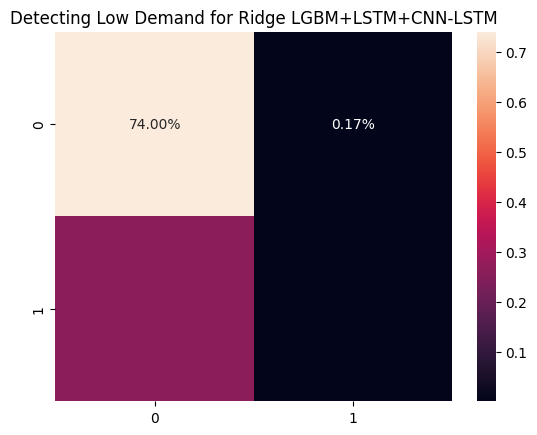

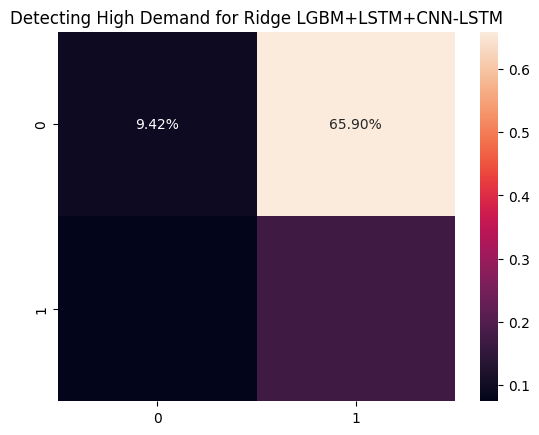

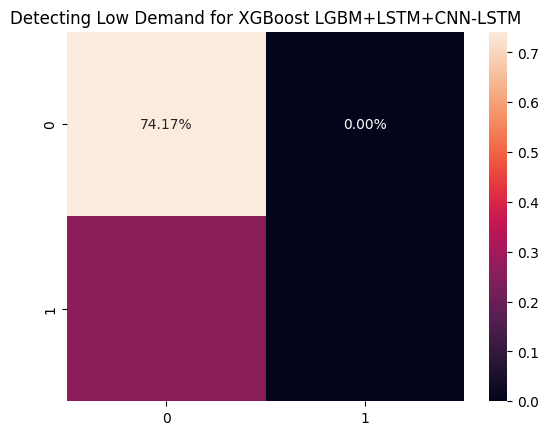

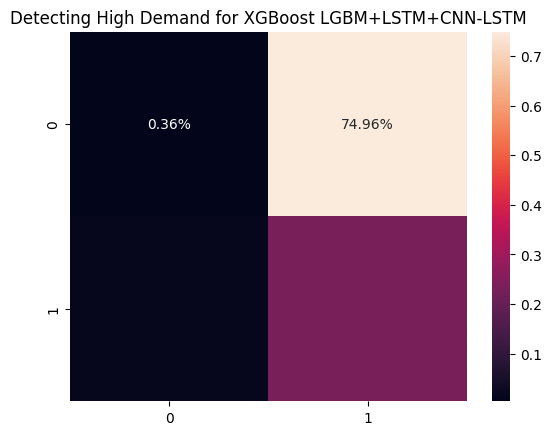

In [147]:
from sklearn.metrics import confusion_matrix
for single_eval in single_eval_df.iloc[:,:-1].columns:
    actual_low_demand_percentile = np.where(single_eval_df['actual'] <= low_demand_threshold, 1,0)
    predicted_low_demand_perecentile = np.where(single_eval_df[single_eval] <= low_demand_threshold, 1,0)
    actual_high_demand_percentile = np.where(single_eval_df['actual'] >= high_demand_threshold, 1,0)
    predicted_high_demand_percentile = np.where(single_eval_df[single_eval]>= high_demand_threshold, 1,0)
    low_demand_confusion_matrix = confusion_matrix(actual_low_demand_percentile, predicted_low_demand_perecentile)
    sns.heatmap(low_demand_confusion_matrix/np.sum(low_demand_confusion_matrix), annot = True, fmt = '.2%')
    plt.title(f'Detecting Low Demand for {single_eval}')
    plt.show()
    high_demand_confusion_matrix = confusion_matrix(actual_high_demand_percentile, predicted_high_demand_percentile)
    sns.heatmap(high_demand_confusion_matrix/np.sum(high_demand_confusion_matrix), annot = True, fmt = '.2%')
    plt.title(f'Detecting High Demand for {single_eval}')
    plt.show()
    


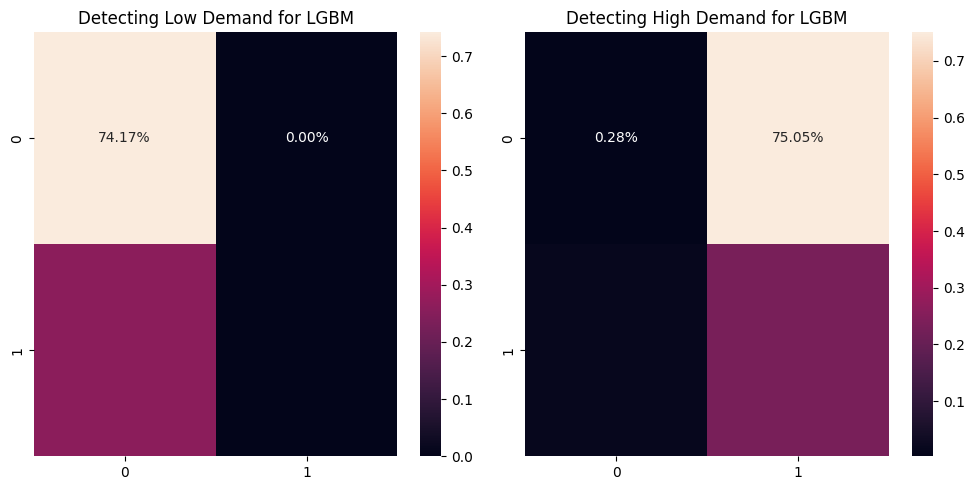

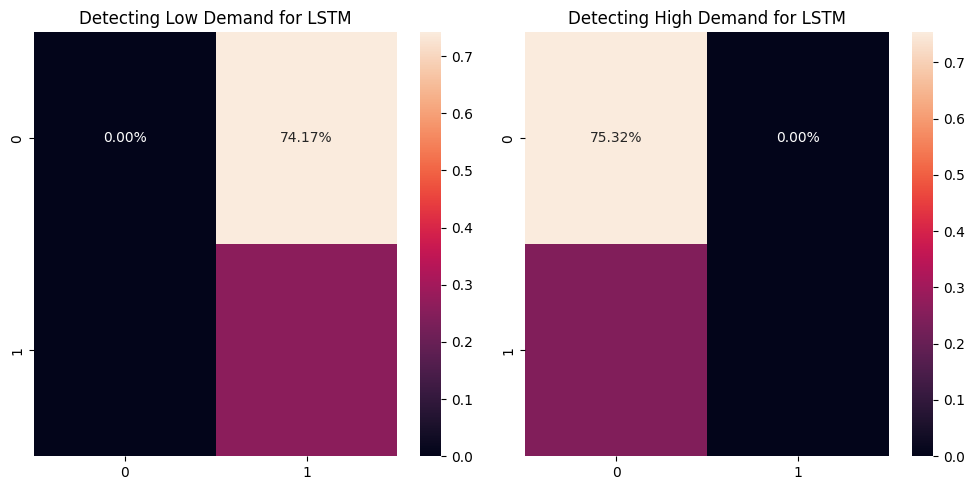

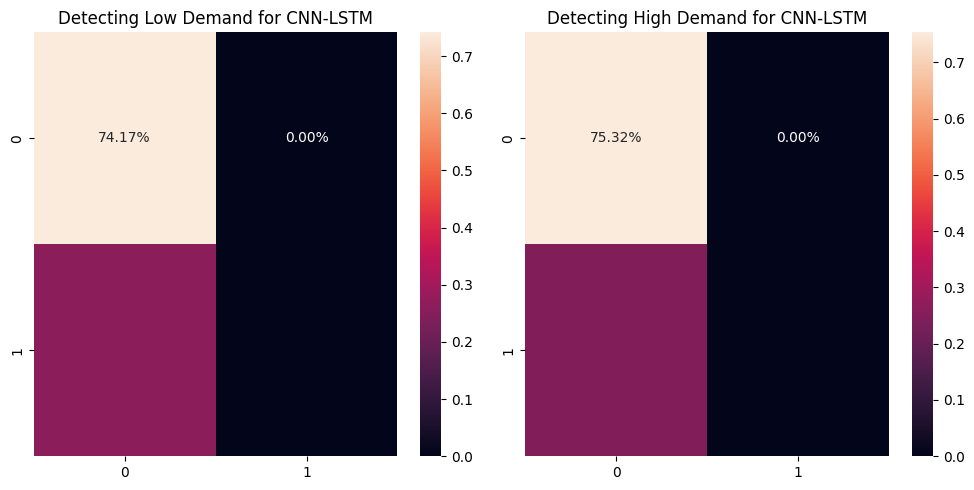

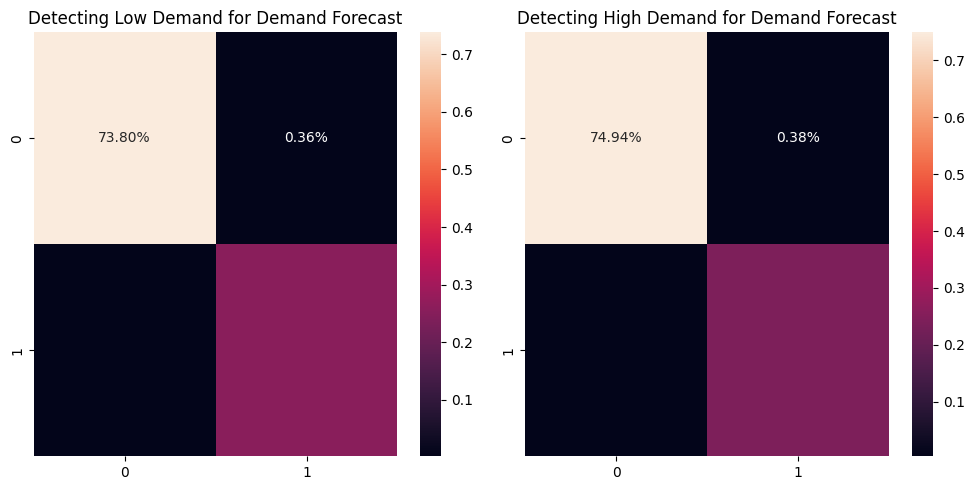

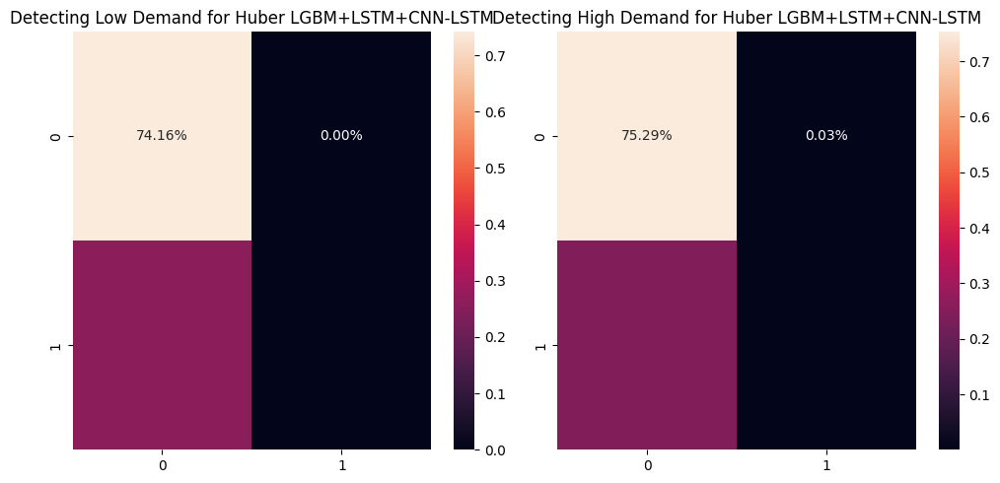

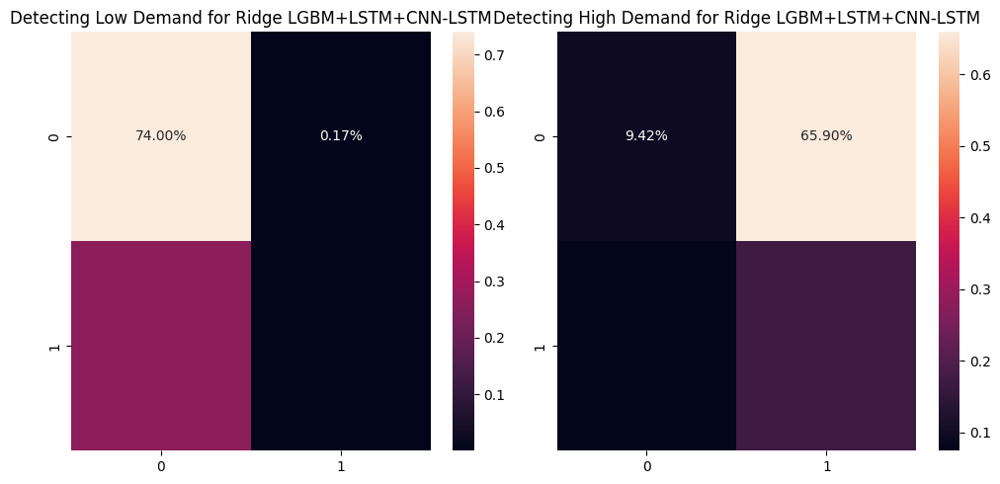

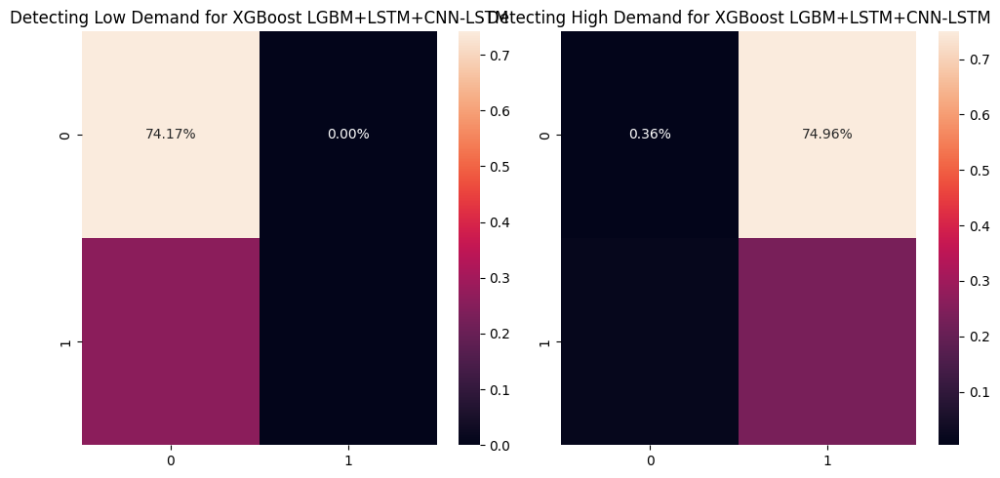

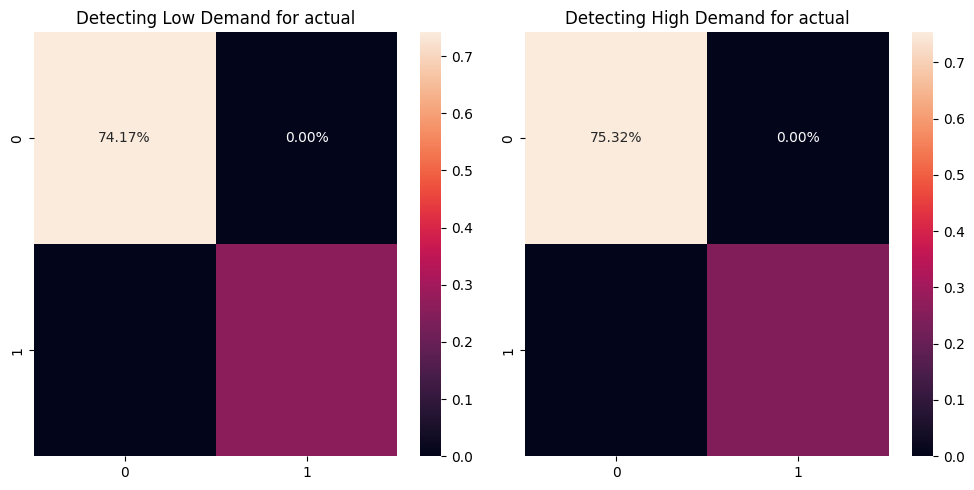

In [148]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

# Assuming you have defined low_demand_threshold and high_demand_threshold somewhere

for single_eval in single_eval_df.columns:
    # Calculate actual and predicted percentiles based on thresholds
    actual_low_demand_percentile = np.where(single_eval_df['actual'] <= low_demand_threshold, 1, 0)
    predicted_low_demand_percentile = np.where(single_eval_df[single_eval] <= low_demand_threshold, 1, 0)
    actual_high_demand_percentile = np.where(single_eval_df['actual'] >= high_demand_threshold, 1, 0)
    predicted_high_demand_percentile = np.where(single_eval_df[single_eval] >= high_demand_threshold, 1, 0)
    
    # Calculate confusion matrices
    low_demand_confusion_matrix = confusion_matrix(actual_low_demand_percentile, predicted_low_demand_percentile)
    high_demand_confusion_matrix = confusion_matrix(actual_high_demand_percentile, predicted_high_demand_percentile)
    
    # Visualize confusion matrices
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    sns.heatmap(low_demand_confusion_matrix/np.sum(low_demand_confusion_matrix), annot=True, fmt='.2%')
    plt.title(f'Detecting Low Demand for {single_eval}')
    
    plt.subplot(1, 2, 2)
    sns.heatmap(high_demand_confusion_matrix/np.sum(high_demand_confusion_matrix), annot=True, fmt='.2%')
    plt.title(f'Detecting High Demand for {single_eval}')
    
    plt.tight_layout()  # Adjust layout to prevent overlapping
    plt.show()


In [ ]:
def multi_step_forecast(data, model, steps=10):
    forecast = []
    for i in range(steps):
        one_step_pred = model.predict(np.array(data).reshape(1,-1))[0]
        forecast.append(one_step_pred)
        _ = data.pop(0)
        data.append(one_step_pred)
    return np.array(forecast)

In [ ]:
multi_step_lgbm = multi_step_forecast(x_test.iloc[-1].tolist(), lgbm_model, steps = 113166)
multi_step_lgbm


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

array([ 8027.54031399, 23853.8302294 , 30713.31067947, ...,
       19613.65162645, 19613.65162645, 19613.65162645])

In [ ]:
multi_lgbm_rmse = np.sqrt(mean_squared_error(ml_df['Demand (MW)'].values[split_length:], multi_step_lgbm))
multi_lgbm_mae = mean_absolute_error(ml_df['Demand (MW)'].values[split_length:], multi_step_lgbm)
model_dict['Multi-Step LGBM'] = [multi_lgbm_rmse, multi_lgbm_mae]

In [ ]:
time_steps = df['Balancing Authority'].nunique() * df['Hour Number'].nunique()

In [ ]:
multi_step_train = ml_df[:-time_steps]

In [ ]:
multi_step_test = ml_df[-time_steps:]

In [ ]:
multi_step_x_train = ml_df.drop(['Demand_Shifted', 'Demand (MW)'], axis =1 )[:-time_steps]
multi_step_y_train = ml_df['Demand_Shifted'][:-time_steps]
multi_step_x_test = ml_df.drop(['Demand_Shifted', 'Demand (MW)'], axis =1 )[-time_steps:]
multi_step_y_test = ml_df['Demand_Shifted'][-time_steps:]

In [ ]:
print(multi_step_x_train.shape)
print(multi_step_y_train.shape)

(564527, 25)
(564527,)


In [ ]:
print(multi_step_x_test.shape)
print(multi_step_y_test.shape)

(1300, 25)
(1300,)


In [ ]:
multi_step_x_train= pd.DataFrame(scaler.fit_transform(multi_step_x_train), columns=multi_step_x_train.columns)
multi_step_x_test= pd.DataFrame(scaler.fit_transform(multi_step_x_test), columns=multi_step_x_test.columns)

In [ ]:
param_lgbm = {'min_child_weight': [1,3,5,7], 'max_depth': [5,8,15], 'n_estimators': [300,500,800]}

tscv = TimeSeriesSplit(n_splits=8)
grid_search_multi_step_lgbm = GridSearchCV(LGBMRegressor(), param_grid=param_lgbm, scoring = 'neg_root_mean_squared_error', cv = tscv)
grid_search_multi_step_lgbm.fit(multi_step_x_train, multi_step_y_train)
print('Grid Search RSME:', round(grid_search_lgbm.best_score_, 3))
print('Best Parameters:', grid_search_lgbm.best_params_)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011954 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3987
[LightGBM] [Info] Number of data points in the train set: 62727, number of used features: 25
[LightGBM] [Info] Start training from score 8796.455621
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

In [ ]:
multi_step_lgbm_model = grid_search_multi_step_lgbm.best_estimator_.fit(x_train, y_train)
multi_step_lgbm_predictions = multi_step_forecast(multi_step_x_test.iloc[-1].tolist(), multi_step_lgbm_model, steps = time_steps)


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003586 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4119
[LightGBM] [Info] Number of data points in the train set: 452661, number of used features: 25
[LightGBM] [Info] Start training from score 8968.596183
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

In [ ]:
len(multi_step_lgbm_predictions)

1300

In [ ]:
multi_step_lgbm_rmse = np.sqrt(mean_squared_error(ml_df['Demand (MW)'].values[-time_steps:], multi_step_lgbm_predictions))


In [ ]:
multi_step_lgbm_mae = mean_absolute_error(ml_df['Demand (MW)'].values[-time_steps:], multi_step_lgbm_predictions)
model_dict['Multi-Step LGBM'] = [multi_step_lgbm_rmse, multi_step_lgbm_mae]

In [ ]:
multi_step_train_dataset = create_dataset(multi_step_x_train, multi_step_y_train, sequence_length=sequence_length,batch_size=512)

In [ ]:
lstm_input = Input(shape = [None, x_train.shape[1]])
lstm_x = LSTM(64, return_sequences = True)(lstm_input)
lstm_x = LSTM(32)(lstm_x)
lstm_x = Dropout(0.3)(lstm_x)
lstm_x= Dense(128, activation = 'relu')(lstm_x)
lstm_x = Dropout(0.2)(lstm_x)
lstm_output = Dense(1)(lstm_x)

multi_step_lstm_model = Model(lstm_input, lstm_output)
multi_step_lstm_model.compile(optimizer = 'adam', loss = 'mse', metrics = [RootMeanSquaredError(), MeanAbsoluteError()])
multi_step_lstm_model.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, None, 25)]        0         
                                                                 
 lstm_4 (LSTM)               (None, None, 64)          23040     
                                                                 
 lstm_5 (LSTM)               (None, 32)                12416     
                                                                 
 dropout_4 (Dropout)         (None, 32)                0         
                                                                 
 dense_4 (Dense)             (None, 128)               4224      
                                                                 
 dropout_5 (Dropout)         (None, 128)               0         
                                                                 
 dense_5 (Dense)             (None, 1)                 129 

In [ ]:
multi_step_lstm_model.fit(multi_step_train_dataset, epochs = 20, shuffle = False)

Epoch 1/20
1103/1103 [==============================] - 375s 338ms/step - loss: 557920960.0000 - root_mean_squared_error: 23620.3496 - mean_absolute_error: 8428.1562
Epoch 2/20
1103/1103 [==============================] - 374s 339ms/step - loss: 512920608.0000 - root_mean_squared_error: 22647.7500 - mean_absolute_error: 10054.7969
Epoch 3/20
1103/1103 [==============================] - 355s 322ms/step - loss: 511401120.0000 - root_mean_squared_error: 22614.1797 - mean_absolute_error: 10513.0088
Epoch 4/20
1103/1103 [==============================] - 341s 309ms/step - loss: 510788544.0000 - root_mean_squared_error: 22600.6309 - mean_absolute_error: 10349.3975
Epoch 5/20
1103/1103 [==============================] - 341s 310ms/step - loss: 507579872.0000 - root_mean_squared_error: 22529.5332 - mean_absolute_error: 10316.2725
Epoch 6/20
1103/1103 [==============================] - 340s 308ms/step - loss: 505942944.0000 - root_mean_squared_error: 22493.1758 - mean_absolute_error: 10301.3643

In [ ]:
def to_windows(dataset, length):
    dataset = dataset.window(length, shift=1, drop_remainder=True)
    return dataset.flat_map(lambda window_ds: window_ds.batch(length))

In [ ]:
def to_seq2seq_dataset(series, seq_length=56, ahead=14, target_col=1,
                       batch_size=32, shuffle=False, seed=None):
    ds = to_windows(tensorflow.data.Dataset.from_tensor_slices(series), ahead + 1)
    ds = to_windows(ds, seq_length).map(lambda S: (S[:, 0], S[:, 1:, 1]))
    if shuffle:
        ds = ds.shuffle(8 * batch_size, seed=seed)
    return ds.batch(batch_size)

In [ ]:
ml_df.columns.get_loc('Demand_Shifted')

26

In [ ]:
ml_df

,Demand (MW),Total Interchange (MW),Sum(Valid DIBAs) (MW),Net Generation (MW) from Hydropower and Pumped Storage,Net Generation (MW) from Solar,Longitude,Latitude,Week_number_sin1,Week_number_cos1,Week_number_sin2,...,Demand_lag3,Demand_lag4,Demand_lag5,ewma_sixty_day_span,ewma_weekly_span,ewma_daily_span,ewma_biweekly_span,ewma_biannual_span,ewma_hourly_span,Demand_Shifted
UTC Time at End of Hour,,,,,,,,,,,,,,,,,,,,,
2023-01-01 06:00:00,2380.000000,-1137.000000,-1137.000000,2.000000,0.000000,-79.039292,35.672964,0.0,1.0,0.0,...,2578.000000,2514.000000,2394.000000,2946.507069,2947.802443,2947.802443,2980.049679,2944.529405,2698.755027,1808.000000
2023-01-01 06:00:00,1808.000000,68.000000,62.000000,531.415027,0.000000,-81.463983,27.756767,0.0,1.0,0.0,...,2057.000000,1923.000000,1761.000000,2122.990651,2090.191780,2090.191780,2103.363804,2212.272668,1967.329195,75969.000000
2023-01-01 06:00:00,75969.000000,3510.000000,6513.000000,1132.000000,8.000000,-77.727883,40.969989,0.0,1.0,0.0,...,75226.000000,75503.000000,75206.000000,92399.955973,89932.809355,89932.809355,92101.852489,87549.852136,80920.663745,14247.000000
2023-01-01 06:00:00,14247.000000,-2421.000000,-2422.000000,2600.000000,0.000000,-74.006015,40.712728,0.0,1.0,0.0,...,14458.000000,14355.000000,14080.000000,16947.121412,16573.172491,16573.172491,16841.365151,16278.599248,15226.320641,4783.000000
2023-01-01 06:00:00,4783.000000,-53.000000,-52.000000,14.000000,-1.000000,-79.039292,35.672964,0.0,1.0,0.0,...,5247.000000,5185.000000,4777.000000,6824.550203,6807.981978,6807.981978,6930.351432,7320.692715,5982.147941,1503.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-03-30 07:00:00,2405.888889,-1234.333333,-1234.333333,49.000000,1.333333,-114.015407,43.644764,1.0,-0.0,1.0,...,2529.666667,2591.555556,2653.444444,3126.875158,2956.639754,2956.639754,2967.784814,3159.314515,2750.432958,493.444444
2024-03-30 07:00:00,493.444444,-373.777778,-373.777778,119.666667,0.000000,-114.015407,43.644764,1.0,-0.0,1.0,...,512.333333,521.777778,531.222222,614.542333,586.756374,586.756374,588.780330,598.949930,552.155008,917.777778
2024-03-30 07:00:00,917.777778,-636.000000,-636.000000,281.777778,0.755831,-114.015407,43.644764,1.0,-0.0,1.0,...,973.333333,1001.111111,1028.888889,1201.210737,1151.590136,1151.590136,1151.953173,1218.277716,1070.786192,1286.888889


In [ ]:
tf_ml_df = ml_df.drop('Demand (MW)', axis =1)

In [ ]:
seq2seq_train = to_seq2seq_dataset(np.asarray(tf_ml_df.values).astype(np.float32), seq_length=168, ahead=1300, target_col=tf_ml_df.columns.get_loc('Demand_Shifted'))

In [ ]:
lstm_input = Input(shape = [None, x_train.shape[1]+1])
lstm_x = LSTM(64, return_sequences = True)(lstm_input)
lstm_x = LSTM(32, return_sequences=True)(lstm_x)
lstm_x = Dropout(0.3)(lstm_x)
lstm_x= Dense(128, activation = 'relu')(lstm_x)
lstm_x = Dropout(0.2)(lstm_x)
lstm_output = Dense(1300)(lstm_x)

multi_step_lstm_model = Model(lstm_input, lstm_output)
multi_step_lstm_model.compile(optimizer = 'adam', loss = 'mse', metrics = [RootMeanSquaredError(), MeanAbsoluteError()])
multi_step_lstm_model.summary()

Model: "model_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_7 (InputLayer)        [(None, None, 26)]        0         
                                                                 
 lstm_12 (LSTM)              (None, None, 64)          23296     
                                                                 
 lstm_13 (LSTM)              (None, None, 32)          12416     
                                                                 
 dropout_12 (Dropout)        (None, None, 32)          0         
                                                                 
 dense_12 (Dense)            (None, None, 128)         4224      
                                                                 
 dropout_13 (Dropout)        (None, None, 128)         0         
                                                                 
 dense_13 (Dense)            (None, None, 1300)        1677

In [ ]:
multi_step_lstm_model.fit(seq2seq_train, epochs = 10, shuffle=False)

Epoch 1/20
17637/17637 [==============================] - 3150s 179ms/step - loss: 3664091.0000 - root_mean_squared_error: 1914.3016 - mean_absolute_error: 1048.8651
Epoch 2/20
17637/17637 [==============================] - 3222s 183ms/step - loss: 3664251.7500 - root_mean_squared_error: 1914.3489 - mean_absolute_error: 1048.7094
Epoch 3/20
17637/17637 [==============================] - 3177s 180ms/step - loss: 3664234.7500 - root_mean_squared_error: 1914.3433 - mean_absolute_error: 1048.6260
Epoch 4/20
17637/17637 [==============================] - 3136s 178ms/step - loss: 3664184.0000 - root_mean_squared_error: 1914.3317 - mean_absolute_error: 1048.6406
Epoch 5/20
17637/17637 [==============================] - 3371s 191ms/step - loss: 3664204.0000 - root_mean_squared_error: 1914.3336 - mean_absolute_error: 1048.6650
Epoch 6/20
 8304/17637 [=============>................] - ETA: 35:50 - loss: 3827601.5000 - root_mean_squared_error: 1956.5295 - mean_absolute_error: 1073.3380

KeyboardInterrupt: 

In [ ]:
cnn_lstm_input = Input(shape = [None, x_train.shape[1]])
padding = tensorflow.constant([[0,0], [5,0], [0,0]])
padding_input = tensorflow.pad(cnn_lstm_input, padding, 'CONSTANT')
cnn_x = Conv1D(filters = 100, kernel_size = 3, activation = 'relu', padding = 'same')(padding_input)
max_pool_x = MaxPooling1D(2)(cnn_x)
cnn_lstm_x = LSTM(64, return_sequences = True)(max_pool_x)
cnn_lstm_x = LSTM(32)(cnn_lstm_x)
cnn_lstm_x = Dropout(0.3)(cnn_lstm_x)
cnn_lstm_x= Dense(128, activation = 'relu')(cnn_lstm_x)
cnn_lstm_x = Dropout(0.2)(cnn_lstm_x)
cnn_lstm_output = Dense(1)(cnn_lstm_x)

multi_step_cnn_lstm_model = Model(cnn_lstm_input, cnn_lstm_output)
multi_step_cnn_lstm_model.compile(optimizer = 'adam', loss = 'mse', metrics = [RootMeanSquaredError(), MeanAbsoluteError()])
multi_step_cnn_lstm_model.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, None, 25)]        0         
                                                                 
 tf.compat.v1.pad_1 (TFOpLa  (None, None, 25)          0         
 mbda)                                                           
                                                                 
 conv1d_1 (Conv1D)           (None, None, 100)         7600      
                                                                 
 max_pooling1d_1 (MaxPoolin  (None, None, 100)         0         
 g1D)                                                            
                                                                 
 lstm_6 (LSTM)               (None, None, 64)          42240     
                                                                 
 lstm_7 (LSTM)               (None, 32)                1241

In [ ]:
multi_step_cnn_lstm_model.fit(seq2seq_train, epochs = 10, shuffle = False)